<h1 align="center">Visual Behavior Neuropixels SWDB 2022 </h1>
<h2 align="center">Session Analysis for Representational Drift</h2>
<h3 align="center">Entrypoint</h3>

# SET UP - Pick Session
set up the cache, define a session, view metadata and set up respective tables

### 0.1 imports

In [1]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec #Useful tool to arrange multiple plots in one figure (https://matplotlib.org/stable/api/_as_gen/matplotlib.gridspec.GridSpec.html)
from matplotlib.patches import Patch
from matplotlib.patches import Rectangle

from tqdm import tqdm 

from util import set_up_cache, get_session, plot_unit_spikes, plot_one_trial, plot_trials, plot_trials_chron, plot_trials_timeline, horizontal_bar_plot_trials, trials_data_description
from util_eda import get_missing_durations, create_unit_activity_vectors, plot_stimulus_presentations_with_activities, get_unit_activity_vectors_for_image, average_population_response_over_same_stimulus_presentations, count_same_image_appearences, extract_speed_and_pupil_data, plot_active_vs_passive_RS_running_speed_and_pupil_area_over_time, running_speeds_and_pupil_areas, count_all_same_image_appearences, construct_unit_activity_population_response_matrix
from util_RS_plots import specific_image, plot_layered_RS_running_speed_and_pupil_area_all_images, RS_behaviour_active_passive, RS_vs_time_avg_active_passive, correlation_between_picture_pair, RS_behaviour_avg, RS_vs_time_active_passive_within_blocks, tuning_curves_time_dependent, specific_image_z_scored_behaviour, plot_tuning_curves_time_dependent, get_all_tunings, show_tunings_norm_each_unit, show_tunings_norm_each_bin, plot_tuning_curves_time_dependent_all_images_layered, z_score_behaviour_full
from optotagging import get_cre_pos_unit_ids_from_optotagging

%matplotlib inline

%load_ext autoreload
%autoreload 2
%aimport util

import util

### 0.2 set up cache

In [2]:
cache = set_up_cache()

In [3]:
ecephys_sessions_table = cache.get_ecephys_session_table()
ecephys_sessions_table.head()

,behavior_session_id,date_of_acquisition,equipment_name,session_type,mouse_id,genotype,sex,project_code,age_in_days,unit_count,...,channel_count,structure_acronyms,image_set,prior_exposures_to_image_set,session_number,experience_level,prior_exposures_to_omissions,file_id,abnormal_histology,abnormal_activity
ecephys_session_id,,,,,,,,,,,,,,,,,,,,,
1044385384,1044408432,2020-08-19 14:47:08.574000+00:00,NP.1,EPHYS_1_images_G_5uL_reward,524761,wt/wt,F,NeuropixelVisualBehavior,151,2179.0,...,1920.0,"['CA1', 'CA3', 'DG-mo', 'DG-po', 'DG-sg', 'LGv...",G,30.0,1,Familiar,0,870,NaN,NaN
1044594870,1044624428,2020-08-20 15:03:56.422000+00:00,NP.1,EPHYS_1_images_H_5uL_reward,524761,wt/wt,F,NeuropixelVisualBehavior,152,2103.0,...,1920.0,"['CA1', 'CA3', 'DG-mo', 'DG-po', 'DG-sg', 'HPF...",H,0.0,2,Novel,1,872,NaN,NaN
1047969464,1048005547,2020-09-02 14:53:14.347000+00:00,NP.1,EPHYS_1_images_G_3uL_reward,509808,Sst-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt,M,NeuropixelVisualBehavior,263,2438.0,...,2304.0,"['APN', 'CA1', 'CA3', 'DG-mo', 'DG-po', 'DG-sg...",G,62.0,1,Familiar,0,877,NaN,NaN
1047977240,1048009327,2020-09-02 15:15:03.733000+00:00,NP.0,EPHYS_1_images_G_3uL_reward,524925,Sst-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt,F,NeuropixelVisualBehavior,165,1856.0,...,2304.0,"['APN', 'CA1', 'CA3', 'DG-mo', 'DG-po', 'DG-sg...",G,51.0,1,Familiar,0,878,NaN,NaN
1048189115,1048221709,2020-09-03 14:16:57.913000+00:00,NP.1,EPHYS_1_images_H_3uL_reward,509808,Sst-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt,M,NeuropixelVisualBehavior,264,1925.0,...,2304.0,"['APN', 'CA1', 'CA3', 'DG-mo', 'DG-po', 'DG-sg...",H,0.0,2,Novel,1,879,NaN,NaN


In [4]:
len(ecephys_sessions_table)

103

In [5]:
sst_vip_sessions = ecephys_sessions_table[(ecephys_sessions_table['genotype'].str.contains('Sst')) | (ecephys_sessions_table['genotype'].str.contains('Vip'))]
len(sst_vip_sessions)

65

In [6]:
novel_sessions = ecephys_sessions_table[ecephys_sessions_table['experience_level']=='Novel']
novel_sessions['image_set'].value_counts()

H    42
G    10
Name: image_set, dtype: int64

### 0.3 mouse stuff

In [7]:
ecephys_sessions_table[ecephys_sessions_table['experience_level']=='Novel'].head(3)

,behavior_session_id,date_of_acquisition,equipment_name,session_type,mouse_id,genotype,sex,project_code,age_in_days,unit_count,...,channel_count,structure_acronyms,image_set,prior_exposures_to_image_set,session_number,experience_level,prior_exposures_to_omissions,file_id,abnormal_histology,abnormal_activity
ecephys_session_id,,,,,,,,,,,,,,,,,,,,,
1044594870,1044624428,2020-08-20 15:03:56.422000+00:00,NP.1,EPHYS_1_images_H_5uL_reward,524761,wt/wt,F,NeuropixelVisualBehavior,152,2103.0,...,1920.0,"['CA1', 'CA3', 'DG-mo', 'DG-po', 'DG-sg', 'HPF...",H,0.0,2,Novel,1,872,NaN,NaN
1048189115,1048221709,2020-09-03 14:16:57.913000+00:00,NP.1,EPHYS_1_images_H_3uL_reward,509808,Sst-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt,M,NeuropixelVisualBehavior,264,1925.0,...,2304.0,"['APN', 'CA1', 'CA3', 'DG-mo', 'DG-po', 'DG-sg...",H,0.0,2,Novel,1,879,NaN,NaN
1048196054,1048222325,2020-09-03 14:25:07.290000+00:00,NP.0,EPHYS_1_images_H_3uL_reward,524925,Sst-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt,F,NeuropixelVisualBehavior,166,2288.0,...,2304.0,"['APN', 'CA1', 'CA3', 'DG-mo', 'DG-po', 'DG-sg...",H,0.0,2,Novel,1,880,NaN,NaN


In [8]:
# ecephys_sessions_table[ecephys_sessions_table['mouse_id']==527749] # originial mouse
# ecephys_sessions_table[ecephys_sessions_table['mouse_id']==524761] # different mouse 1
# ecephys_sessions_table[ecephys_sessions_table['mouse_id']==577287] # different mouse 2
ecephys_sessions_table[ecephys_sessions_table['mouse_id']==568963] # different mouse 3 Vip

,behavior_session_id,date_of_acquisition,equipment_name,session_type,mouse_id,genotype,sex,project_code,age_in_days,unit_count,...,channel_count,structure_acronyms,image_set,prior_exposures_to_image_set,session_number,experience_level,prior_exposures_to_omissions,file_id,abnormal_histology,abnormal_activity
ecephys_session_id,,,,,,,,,,,,,,,,,,,,,
1111013640,1111047108,2021-06-23 13:11:39.631000+00:00,NP.1,EPHYS_1_images_G_3uL_reward,568963,Vip-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt,M,NeuropixelVisualBehavior,161,2814.0,...,2304.0,"['APN', 'CA1', 'CA3', 'DG-mo', 'DG-po', 'DG-sg...",G,49.0,1,Familiar,0,987,NaN,NaN
1111216934,1111250074,2021-06-24 13:59:17.563000+00:00,NP.1,EPHYS_1_images_H_3uL_reward,568963,Vip-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt,M,NeuropixelVisualBehavior,162,1744.0,...,2304.0,"['APN', 'CA1', 'CA3', 'DG-mo', 'DG-po', 'DG-sg...",H,0.0,2,Novel,1,988,NaN,NaN


In [9]:
ecephys_sessions_table.loc[sessionID].experience_level

NameError: name 'sessionID' is not defined

# all sessions

In [10]:
'hello', f"length of hello: {len('hello')}"

('hello', 'length of hello: 5')

### session classes

In [11]:
class Unit_Activities:
    def __init__(self, image, unit_set, x_timings, y_active, y_passive, y_act_pas, half):
        self.unit_set = unit_set
        self.image = image
        self.x_timings = x_timings
        self.y_active = y_active
        self.y_passive = y_passive
        self.y_act_pas = y_act_pas
        
        self.half = half
        
    def __str__(self):
        return f"Resp. of {self.unit_set} for image {self.image}"

    def info(self):
        print(f"Hello I'm {self.unit_set} in response to stimuli {self.image}")
      

In [12]:
class Z_delta_RS:
    def __init__(self, image, unit_set, x_im_a, y_im_a, x_im_p, y_im_p, x_im_b, y_im_b, x_all, y_all):
        self.unit_set = unit_set
        self.image = image
        # x:
        self.x_im_a = x_im_a
        self.x_im_p = x_im_p
        self.x_im_b = x_im_b
        self.x_all = x_all
        # y:
        self.y_im_a = y_im_a
        self.y_im_p = y_im_p
        self.y_im_b = y_im_b
        self.y_all = y_all
        
        
    def __str__(self):
        return f"delta Z-behaviour and RS of {self.unit_set} for image {self.image}"

    def info(self):
        print(f"Hello I'm delta Z-behaviour and RS with {self.unit_set} in response to stimuli {self.image}")

In [13]:
class Sess:
    def __init__(self, sessionID, mouseID, novel, gen_type, sex, M_good_VIS, M_good_VISp, M_good_VIS_excld_VISp, M_good_CA1):
        self.sessionID = sessionID
        self.mouseID = mouseID
        self.novel = novel
        self.gen_type = gen_type
        self.sex = sex
        self.M_good_VIS = M_good_VIS
        self.M_good_VISp = M_good_VISp
        self.M_good_VIS_excld_VISp = M_good_VIS_excld_VISp
        self.M_good_CA1 = M_good_CA1
        self.responses = []
        self.behaviour = []
        self.task_related = []
        
    def __str__(self):
        return f"Responses of session {self.sessionID} (mouse {self.mouseID}) currently {len(self.responses)}"
        
    def info(self):
        print(f"Hello I'm session {self.sessionID} of mouse {self.mouseID} with type {self.gen_type} and sex {self.sex}, novel={self.novel}")
       
    def basic_repr_similarity(self, image, M, unit_name, sp):
        print(f"adding {unit_name} data for {image}...")
        # final_Repr_Sim_plot(image, M, sp, unit_name, self.sessionID)
        
        x, active, passive, active_passive, half = get_single_plot_content(image, M, sp)
        resp = Unit_Activities(image, unit_name, x, active, passive, active_passive, half)
        self.responses.append(resp)
        
    def behaviour_repr_similarity(self, image, M, unit_name, sp, run_speed, eye_track):
        print(f"adding {unit_name} data for {image}... and behaviour data")
        x_im_a, y_im_a, x_im_p, y_im_p, x_im_b, y_im_b, x_all, y_all = get_delta_behaviour_plot_content(image, M, sp, run_speed, eye_track)
        b_rs = Z_delta_RS(image, unit_name, x_im_a, y_im_a, x_im_p, y_im_p, x_im_b, y_im_b, x_all, y_all)
        self.behaviour.append(b_rs)
        
    def novel_repr_similarity(self, image, M, unit_name, sp):
        print(f"adding {unit_name} data for {image}...")
        x, active, passive, active_passive, half = get_single_plot_content(image, M, sp)
        t_r = Unit_Activities(image, unit_name, x, active, passive, active_passive, half)
        self.task_related.append(t_r)

In [14]:
def get_single_plot_content(image_name, M, stimulus_presentations):

    # dimension reduction: average population response over chains of same stimuli (binning and avg)
    M_reduced, M_rd_active, M_rd_passive, timings, timings_start_end = average_population_response_over_same_stimulus_presentations(M, image_name, stimulus_presentations)

    # get the Representational Similarity
    C_reduced = np.corrcoef(np.transpose(M_reduced))            # the Correlation Matrix with reduced stimuli
    C_rd_active = np.corrcoef(np.transpose(M_rd_active))        # within active block
    C_rd_passive = np.corrcoef(np.transpose(M_rd_passive))      # within passive block

    half = len(C_rd_active)

    across_blocks = C_reduced[half:, :half]                    # lower middle correlation matrix
    across_blocks2 = C_reduced[:half, half:]                   # passive block? - lower right corr matrix
    
    return timings, C_rd_active[0,:], C_rd_passive[0,:], across_blocks2[0,:], half
    

In [15]:
from itertools import combinations, product
from numpy.polynomial.polynomial import polyfit

def get_delta_behaviour_plot_content(image, M, stimulus_presentations, running_speed, eye_tracking):

    M_avg_im, M_avg_im_a, M_avg_im_passive, timings_im, timings_start_end_im = average_population_response_over_same_stimulus_presentations(M, image, stimulus_presentations)

    # get the Representational Similarity
    C_avg = np.corrcoef(np.transpose(M_avg_im))            # the Correlation Matrix with reduced stimuli

    sp = stimulus_presentations[stimulus_presentations.image_name == image]
    avg_running_speed, std_running_speed, avg_pupil_area, std_pupil_area = extract_speed_and_pupil_data(sp, timings_start_end_im, running_speed, eye_tracking)

    assert len(C_avg) == len(avg_running_speed)
    assert len(C_avg) == len(avg_pupil_area)

    n = len(C_avg)
    half = int(n/2)

    z_t = z_score_behaviour_full(avg_running_speed, avg_pupil_area)

    x_im_a = []
    y_im_a = []
    x_im_p = []
    y_im_p = []
    x_im_b = []
    y_im_b = []
    x_all = []
    y_all = []

    for pair in combinations(range(n), 2):
        i, j = pair

        delta_V = np.linalg.norm(z_t[i] - z_t[j])
        
        if (i < half) and (j < half):
            # within active block
            # active
            x_im_a.append(delta_V)
            y_im_a.append(C_avg[i, j])
        elif (i >= half) and (j >= half):
            # within passive block
            # passive
            x_im_p.append(delta_V)
            y_im_p.append(C_avg[i, j])
        else:
            x_im_b.append(delta_V)
            y_im_b.append(C_avg[i,j])
        
        x_all.append(delta_V)
        y_all.append(C_avg[i,j])
    
    return x_im_a, y_im_a, x_im_p, y_im_p, x_im_b, y_im_b, x_all, y_all

### local loop (fast because only 4 sessions, that are saved on system)

In [16]:
# plot all sessions mean Representational Similarity with std fill 
'hello'

'hello'

In [17]:
def all_sessions_loop(sessions):
    
    session_data = []
    for sessionID in sessions:
        print(f"--loading session {sessionID}")
        session = get_session(session_id=sessionID)
        mouse_id = session.metadata['mouse_id']

        print('--loading tables and units')
        # tables:
        stimulus_presentations = session.stimulus_presentations
        units = session.get_units()
        units.head()
        channels = session.get_channels()
        channels.head(3)
        units = units.merge(channels, left_on='peak_channel_id', right_index=True)
        trials = session.trials
        change_trials = trials[trials.is_change]
        spike_times = session.spike_times
        running_speed = session.running_speed
        eye_tracking = session.eye_tracking
        rewards = session.rewards

        # units:
        # Filter units by the quality criteria
        good_units = units[(units['quality']=='good') &
                           (units['firing_rate']>1) &
                           (units['snr']>1) &
                           (units['isi_violations']<1)]

        good_VISp_units = good_units[good_units['structure_acronym']=='VISp']
        good_CA1_units = good_units[good_units['structure_acronym']=='CA1']
        good_VIS_units = good_units[good_units['structure_acronym'].str.contains('VIS')]
        good_VISpm_units = good_units[good_units['structure_acronym'] == 'VISpm']
        all_VISp_units = good_units[good_units['structure_acronym'].str.contains('VISp')]
        good_non_VISp_units = good_units[good_units['structure_acronym']!='VISp']
        good_VIS_without_VISp_units = good_non_VISp_units[good_non_VISp_units['structure_acronym'].str.contains('VIS')]
        assert len(good_VIS_units) == (len(good_VIS_without_VISp_units)+len(good_VISp_units))
        
        cells = False
        # tagged units:
        if 'Sst' in session.metadata['full_genotype']:
            gen_type = 'Sst'
            cells = True
        elif 'Vip' in session.metadata['full_genotype']:
            gen_type = 'Vip'
            cells = True
        else:
            gen_type = 'wt'  
            
        if cells:
            print('--checking optotagging')
            cre_pos_units_from_function = get_cre_pos_unit_ids_from_optotagging(session, structure_acronym='VIS')
            marked_VIS_units = cre_pos_units_from_function.flatten()
            VIS_units_tagged = good_units.loc[marked_VIS_units]
            VIS_units_no_tag = good_VIS_units[~good_VIS_units.index.isin(marked_VIS_units)]
            assert len(VIS_units_no_tag) == len(good_VIS_units) - len(marked_VIS_units)
            M_marked_VIS = construct_unit_activity_population_response_matrix(VIS_units_tagged, spike_times, stimulus_presentations)
            M_VIS_no_tag = construct_unit_activity_population_response_matrix(VIS_units_no_tag, spike_times, stimulus_presentations)

        print('--getting Matrices')
        # Unit Activity Matrices
        # M_all_good = construct_unit_activity_population_response_matrix(good_units, spike_times, stimulus_presentations)
        print('--for VIS')
        M_good_VIS = construct_unit_activity_population_response_matrix(good_VIS_units, spike_times, stimulus_presentations)
        print('--for VISp')
        M_good_VISp = construct_unit_activity_population_response_matrix(good_VISp_units, spike_times, stimulus_presentations)
        print('--for VIS ohne VISp')        
        M_good_VIS_excld_VISp = construct_unit_activity_population_response_matrix(good_VIS_without_VISp_units, spike_times, stimulus_presentations)
        print('--for CA')        
        M_good_CA1 = construct_unit_activity_population_response_matrix(good_CA1_units, spike_times, stimulus_presentations)

        novel=False
        if ecephys_sessions_table.loc[sessionID].experience_level == 'Novel':
            if ecephys_sessions_table.loc[sessionID].image_set == 'H':
                novel = True
        
        sex = ecephys_sessions_table.loc[sessionID].sex

        print('--create session Object')
        s0 = Sess(sessionID, mouse_id, novel, gen_type, sex, M_good_VIS, M_good_VISp, M_good_VIS_excld_VISp, M_good_CA1)
        s0.info()
        s0.basic_repr_similarity(image='im111_r', M=M_good_VISp, unit_name='V1', sp=stimulus_presentations)
        s0.basic_repr_similarity(image='im111_r', M=M_good_VIS_excld_VISp, unit_name='VIS without V1', sp=stimulus_presentations)
        s0.basic_repr_similarity(image='im111_r', M=M_good_CA1, unit_name='CA1', sp=stimulus_presentations)
        
        # behaviour related
        s0.behaviour_repr_similarity(image='im111_r', M=M_good_VISp, unit_name='V1', sp=stimulus_presentations, run_speed=running_speed, eye_track=eye_tracking)
        s0.behaviour_repr_similarity(image='im111_r', M=M_good_VIS_excld_VISp, unit_name='VIS without V1', sp=stimulus_presentations, run_speed=running_speed, eye_track=eye_tracking)
        s0.behaviour_repr_similarity(image='im111_r', M=M_good_CA1, unit_name='CA1', sp=stimulus_presentations, run_speed=running_speed, eye_track=eye_tracking)
        
        if novel:
            # get novel image to compare with familiar
            s0.novel_repr_similarity(image='im114_r', M=M_good_VISp, unit_name='V1', sp=stimulus_presentations)
            s0.novel_repr_similarity(image='im114_r', M=M_good_VIS_excld_VISp, unit_name='VIS without V1', sp=stimulus_presentations)
            s0.novel_repr_similarity(image='im114_r', M=M_good_CA1, unit_name='CA1', sp=stimulus_presentations)
        
        if cells:
            s0.basic_repr_similarity(image='im111_r', M=M_marked_VIS, unit_name='inhibitory', sp=stimulus_presentations)
            s0.basic_repr_similarity(image='im111_r', M=M_VIS_no_tag, unit_name='exhibitory', sp=stimulus_presentations)
        
        session_data.append(s0)

        print(f'session {sessionID} completed--')
    
    return session_data


In [42]:
# loop through all locally saved sessions 
loc_session_ids = [1053941483, 1053718935, 1124285719, 1111013640]
loc_sessions = all_sessions_loop(loc_session_ids)


--loading session 1053941483
--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1053941483 of mouse 527749 with type Sst and sex M, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1053941483 completed--
--loading session 1053718935
--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1053718935 of mouse 527749 with type Sst

In [43]:
loc_sessions[2].task_related[0].image

'im114_r'

In [44]:
len(loc_sessions[3].behaviour[0].x_all), len(loc_sessions[3].behaviour[0].y_all)

(2850, 2850)

### processing/ plotting of all session data

In [19]:
# data per session all im111:
# 0 - V1
# 1 - VIS \ V1
# 2 - CA1
# 3 - tagged VIS (in) - opt
# 4 - untagged VIS (ex) - opt

In [20]:
def conflate_all_session_responses(sessions, k=0):
    
    x_1st_half_list = []  # block0
    x_2nd_half_list = []  # block5
    
    y_1_list = []         # active         RS
    y_2_list = []         # active-passive RS
    y_3_list = []         # passive        RS
    
    for session in sessions:
        half = session.responses[k].half
        
        x = session.responses[k].x_timings      # responses 0 refers to a fix response type with V1
        
        y_1 = session.responses[k].y_active
        y_2 = session.responses[k].y_act_pas
        y_3 = session.responses[k].y_passive
        # y = np.concatenate((y_1, y_2))
        
        x_1st_half_list.append(x[:half])
        x_2nd_half_list.append(x[half:])
        
        y_1_list.append(y_1)
        y_2_list.append(y_2)
        y_3_list.append(y_3)
        
        unit_name = session.responses[k].unit_set
        im_name = session.responses[k].image
        
    
    return x_1st_half_list, x_2nd_half_list, y_1_list, y_2_list, y_3_list, im_name[:-2], unit_name, len(sessions)
        

In [21]:
def conflate_all_session_task_related(sessions, k=0):
    
    x_1st_half_list = []  # block0
    x_2nd_half_list = []  # block5
    
    y_1_list = []         # active         RS
    y_2_list = []         # active-passive RS
    y_3_list = []         # passive        RS
    
    for session in sessions:
        half = session.task_related[k].half
        
        x = session.task_related[k].x_timings      # responses 0 refers to a fix response type with V1
        
        y_1 = session.task_related[k].y_active
        y_2 = session.task_related[k].y_act_pas
        y_3 = session.task_related[k].y_passive
        # y = np.concatenate((y_1, y_2))
        
        x_1st_half_list.append(x[:half])
        x_2nd_half_list.append(x[half:])
        
        y_1_list.append(y_1)
        y_2_list.append(y_2)
        y_3_list.append(y_3)
        
        unit_name = session.task_related[k].unit_set
        im_name = session.task_related[k].image
        
    
    return x_1st_half_list, x_2nd_half_list, y_1_list, y_2_list, y_3_list, im_name[:-2], unit_name, len(sessions)
  

In [158]:
def make_mean_curve(x_1st_half_data, x_2nd_half_data, y_act_data, y_act_pas_data, y_pas_data, image='im111', unit_set='V1', n=9):
    
    x1_list = np.empty(shape=(0,100))
    x2_list = np.empty(shape=(0,100))
    
    y1_list = np.empty(shape=(0,100))
    y2_list = np.empty(shape=(0,100))
    y3_list = np.empty(shape=(0,100))
    
    for i, x1 in enumerate(x_1st_half_data):
        x2 = x_2nd_half_data[i]
        y1 = y_act_data[i]
        y2 = y_pas_data[i]
        y3 = y_act_pas_data[i]
        
        min_x1, max_x1 = min(x1), max(x1)
        new_x1 = np.linspace(min_x1, max_x1, 100)
        min_x2, max_x2 = min(x2), max(x2)
        new_x2 = np.linspace(min_x2, max_x2, 100)
        # print(len(new_x))
        x1_list = np.vstack((x1_list, new_x1))
        x2_list = np.vstack((x2_list, new_x2))
        
        new_y1 = np.interp(new_x1, x1, y1)
        y1_list = np.vstack((y1_list, new_y1))
        new_y2 = np.interp(new_x2, x2, y2)
        y2_list = np.vstack((y2_list, new_y2))
        new_y3 = np.interp(new_x2, x2, y3)
        y3_list = np.vstack((y3_list, new_y3))
        
        
    midx1 = np.mean(x1_list, axis=0)
    midx2 = np.mean(x2_list, axis=0)
    
    midy1 = np.mean(y1_list, axis=0)
    midy2 = np.mean(y2_list, axis=0)
    midy3 = np.mean(y3_list, axis=0)
    
    # print(len(x_list), len(y_list), x_list.shape, y_list.shape, midx.shape, midy.shape)

    fig, ax = plt.subplots(figsize=(16, 8), dpi=360)
    fig.suptitle(t=f'All Sessions: Representational Similarity over Time of {image} in {unit_set} - {n} sessions', fontsize=20)
    
    for i in range(n):
        ax.plot(x_1st_half_data[i], y_act_data[i], c='C0', alpha=0.1)
        ax.plot(x_2nd_half_data[i], y_act_pas_data[i], c='C2', alpha=0.1)

    ax.plot(midx1, midy1, '--', c='darkblue', label='within active')
    ax.plot(midx2, midy3, '--', c='darkgreen', label='across blocks')
    ax.plot(midx2, midy2, '--', c='darkorange', label='within passive', alpha=0.75)

    ax.set_xlabel('time in seconds   -   complete session (2.5h)') 
    ax.set_ylabel('Representational Similarity')
    ax.legend()
    ax.grid()
    
    plt.savefig(f'plots/all_sessions_rs_in_{unit_set}.png')

    return (midx1, midx2, midy1, midy2, midy3)


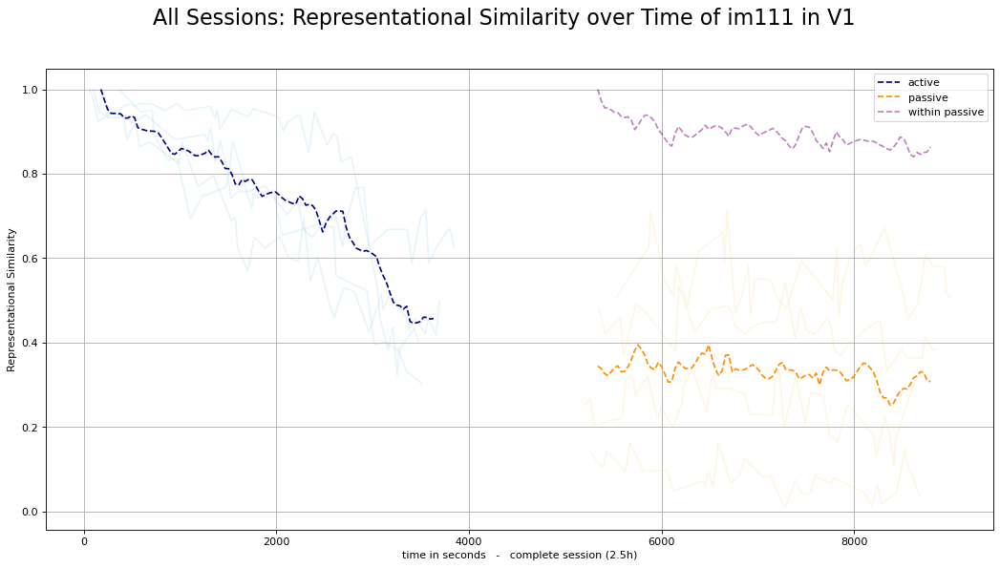

In [278]:
x1, x2, y1, y2, y3, i, u, n = conflate_all_session_responses(loc_sessions, 0)
v1_data = make_mean_curve(x1, x2, y1, y2, y3, i, u, n)

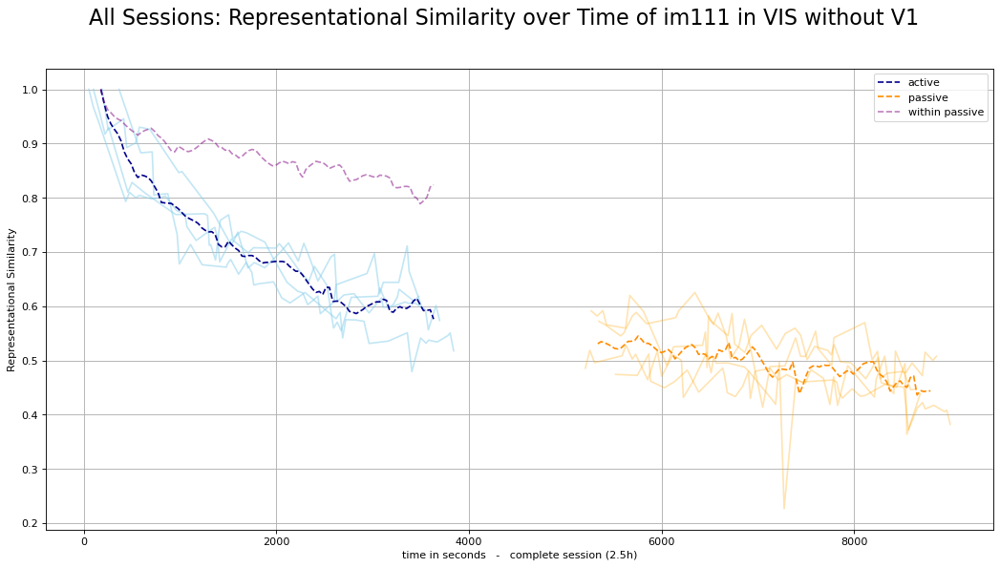

In [29]:
x1, x2, y1, y2, y3, i, u, n = conflate_all_session_responses(loc_sessions, 1)
vis_data = make_mean_curve(x1, x2, y1, y2, y3, i, u, n)

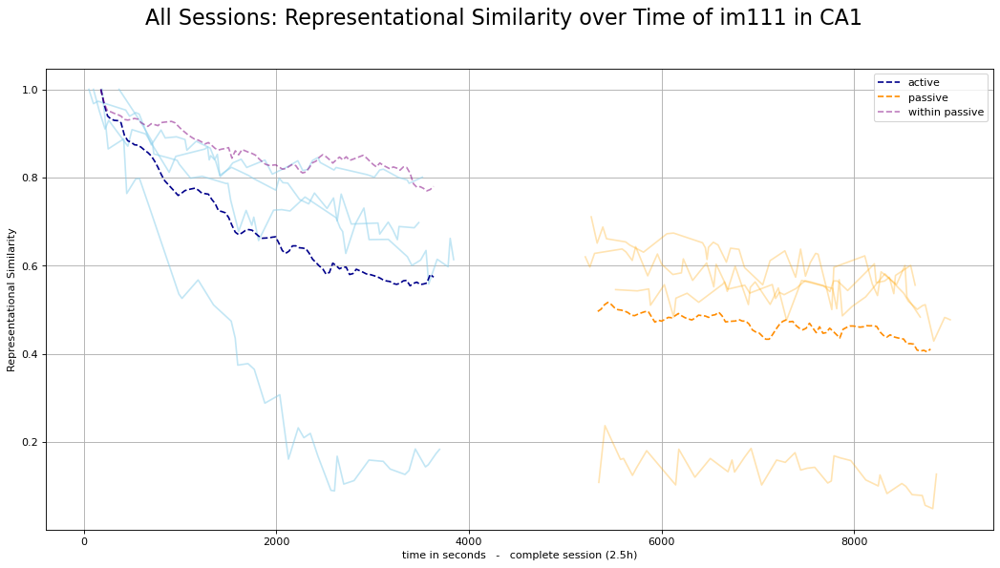

In [30]:
x1, x2, y1, y2, y3, i, u, n = conflate_all_session_responses(loc_sessions, 2)
ca1_data = make_mean_curve(x1, x2, y1, y2, y3, i, u, n)

In [159]:
def all_sessions_by_hierarchy(v1_data, vis_data, ca1_data, n):
    
    (v1_midx1, v1_midx2, v1_midy1, v1_midy2, v1_midy3) = v1_data
    (vis_midx1, vis_midx2, vis_midy1, vis_midy2, vis_midy3) = vis_data
    (ca1_midx1, ca1_midx2, ca1_midy1, ca1_midy2, ca1_midy3) = ca1_data
    
    
    fig, ax = plt.subplots(figsize=(16, 8), dpi=360)
    fig.suptitle(t=f'All Sessions: Representational Similarity over Time by Hierarchy - {n} sessions', fontsize=20)

    ax.plot(v1_midx1, v1_midy1, '--', c='hotpink', label='V1')
    ax.plot(v1_midx2, v1_midy3, '--', c='hotpink')
    ax.plot(v1_midx2, v1_midy2, '--', c='hotpink', alpha=0.5)
    
    ax.plot(vis_midx1, vis_midy1, '--', c='mediumorchid', label='VIS without V1')
    ax.plot(vis_midx2, vis_midy3, '--', c='mediumorchid')
    ax.plot(vis_midx2, vis_midy2, '--', c='mediumorchid', alpha=0.5)
    
    ax.plot(ca1_midx1, ca1_midy1, '--', c='mediumslateblue', label='CA1')
    ax.plot(ca1_midx2, ca1_midy3, '--', c='mediumslateblue')
    ax.plot(ca1_midx2, ca1_midy2, '--', c='mediumslateblue', alpha=0.5)

    ax.set_xlabel('time in seconds   -   complete session (2.5h)') 
    ax.set_ylabel('Representational Similarity')
    ax.legend()
    ax.grid()
    
    plt.savefig(f'plots/all_sessions_rs_by_hierarchy.png')

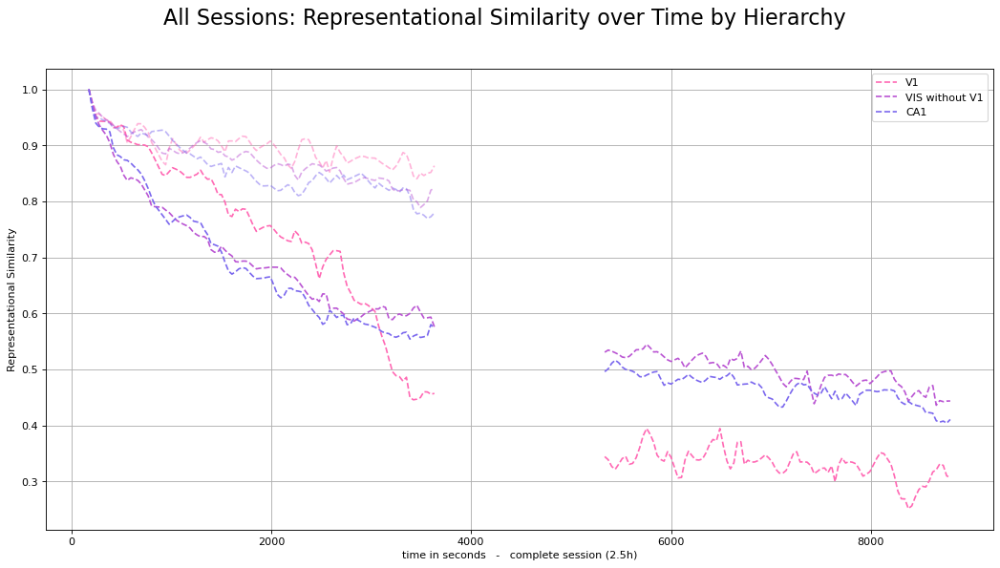

In [32]:
all_sessions_by_hierarchy(v1_data, vis_data, ca1_data, n)

In [177]:
def all_sessions_by_cell_type(in_data, ex_data, n):
    
    (in_midx1, in_midx2, in_midy1, in_midy2, in_midy3) = in_data
    (ex_midx1, ex_midx2, ex_midy1, ex_midy2, ex_midy3) = ex_data

    
    
    fig, ax = plt.subplots(figsize=(16, 8), dpi=360)
    fig.suptitle(t=f'All Sessions: Representational Similarity over Time by Cell Type in VIS - {n} sessions', fontsize=20)

    ax.plot(in_midx1, in_midy1, '--', c='red', label='inhibitory')
    ax.plot(in_midx2, in_midy3, '--', c='red')
    ax.plot(in_midx2, in_midy2, '--', c='red', alpha=0.5)
    
    ax.plot(ex_midx1, ex_midy1, '--', c='blue', label='exhibitory')
    ax.plot(ex_midx2, ex_midy3, '--', c='blue')
    ax.plot(ex_midx2, ex_midy2, '--', c='blue', alpha=0.5)

    ax.set_xlabel('time in seconds   -   complete session (2.5h)') 
    ax.set_ylabel('Representational Similarity')
    ax.legend()
    ax.grid()
    
    plt.savefig(f'plots/all_sessions_rs_by_cell_type.png')

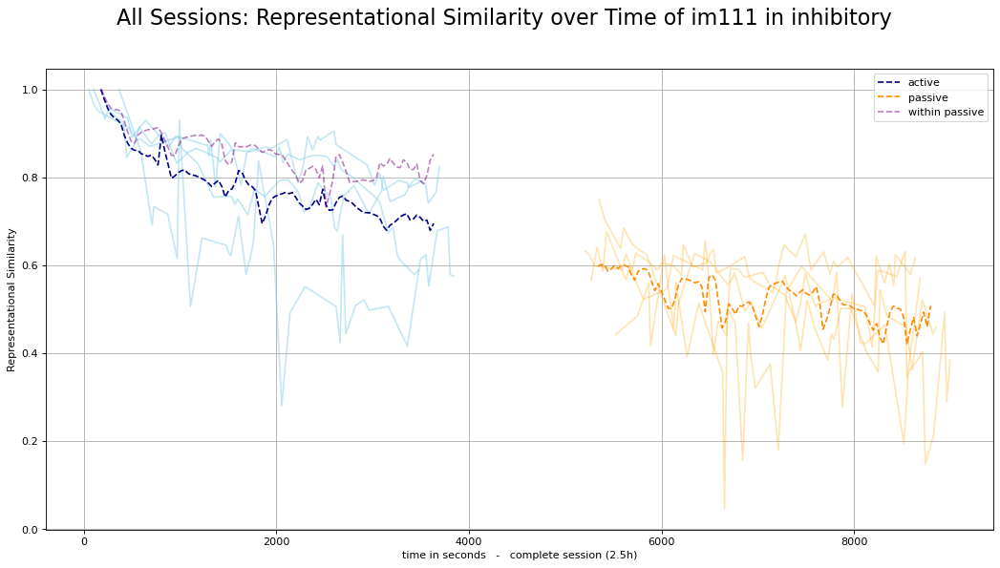

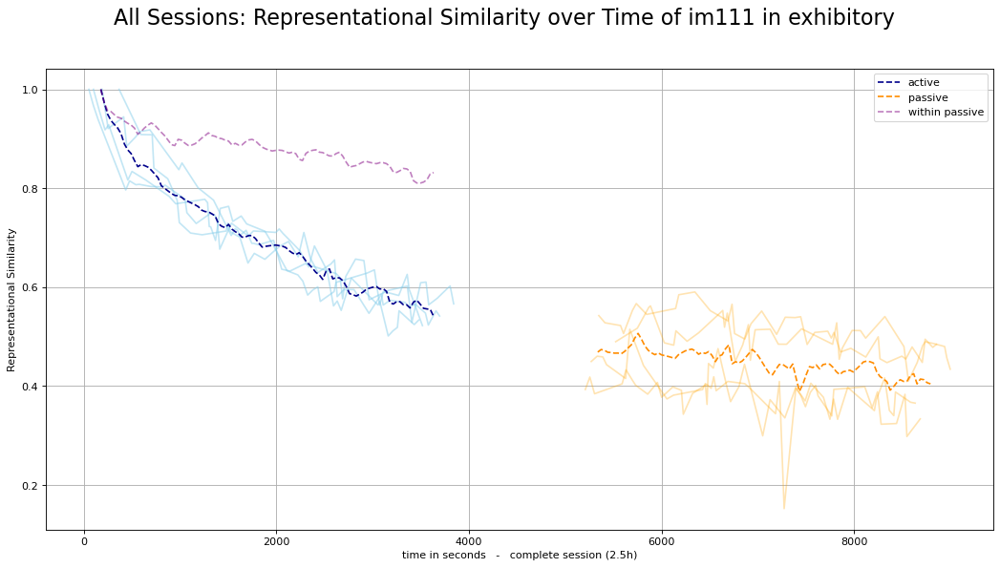

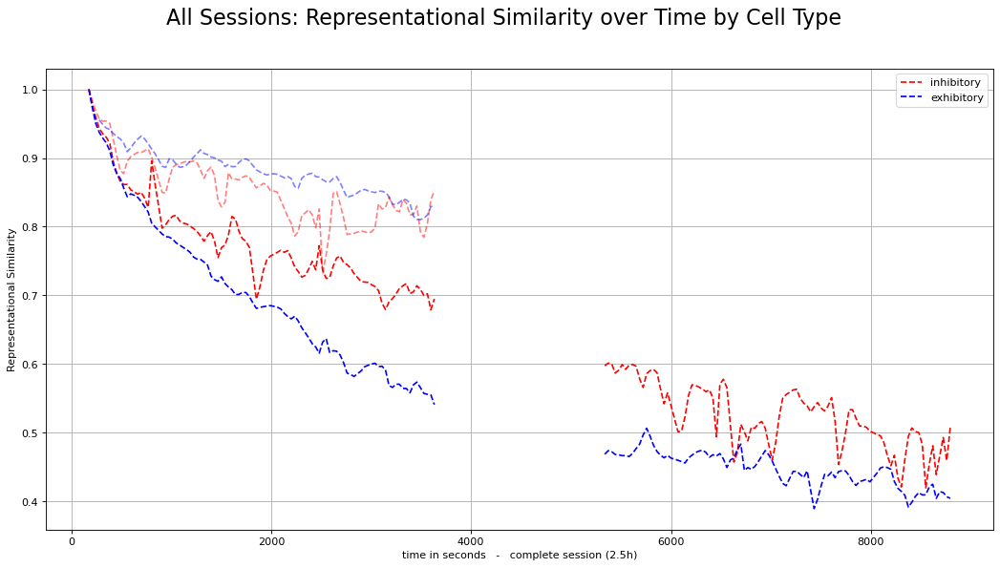

In [34]:
x1, x2, y1, y2, y3, i, u, n = conflate_all_session_responses(loc_sessions, 3)
in_data = make_mean_curve(x1, x2, y1, y2, y3, i, u, n)

x1, x2, y1, y2, y3, i, u, n = conflate_all_session_responses(loc_sessions, 4)
ex_data = make_mean_curve(x1, x2, y1, y2, y3, i, u, n)

all_sessions_by_cell_type(in_data, ex_data, n)

In [25]:
def append_all_session_responses(sessions, k=0):
    
    xa = np.array([])  # block0 # delta Z
    xp = np.array([])  # block5 # delta Z
    
    ya = np.array([])         # active       delta RS
    yp = np.array([])         # passive      delta RS
    
    xb = np.array([]) 
    yb = np.array([]) 
    
    x = np.array([]) 
    y = np.array([])
    
    
    for session in sessions:
        half = session.responses[k].half
        
        # x = session.responses[k].x_timings      # responses 0 refers to a fix response type with V1
        

        # y = np.concatenate((y_1, y_2))
        xa = np.append(xa, np.array(session.behaviour[k].x_im_a))
        xp = np.append(xp, np.array(session.behaviour[k].x_im_p))
        ya = np.append(ya, np.array(session.behaviour[k].y_im_a))
        yp = np.append(yp, np.array(session.behaviour[k].y_im_p))
        xb = np.append(xb, np.array(session.behaviour[k].x_im_b))
        yb = np.append(yb, np.array(session.behaviour[k].y_im_b))
        x = np.append(x, np.array(session.behaviour[k].x_all))
        y = np.append(y, np.array(session.behaviour[k].y_all))
        
        unit_name = session.responses[k].unit_set
        im_name = session.responses[k].image
        
    
    print(len(sessions))
    return xa, ya, xp, yp, xb, yb, x, y, im_name[:-2], unit_name, len(sessions)


In [161]:
def all_sessions_by_delta_b(x_im_a, y_im_a, x_im_p, y_im_p, x_im_b, y_im_b, x_all, y_all, image, brain_structure, n):
    
    b, m = polyfit(x_all, y_all, deg=1)
    
    l=6
    
    fig, axs = plt.subplots(2, 2, figsize=(18, 10), gridspec_kw={'width_ratios': [5, 1], 'height_ratios': [1,3]}, sharex='col', sharey='row', dpi=360)
    fig.tight_layout()
    # axs[1,0].grid(axis='both', color='0.95')
    
    axs[1,0].scatter(x_im_b[::l], y_im_b[::l], alpha=0.25, s=2, c='C2')
    axs[1,0].axhline(0.0, color='gray', linewidth=1, alpha=0.5)
    
    # active
    axs[1,0].scatter(x_im_a[::l], y_im_a[::l], alpha=0.25, s=2)
    axs[0,0].hist(x_im_a, bins=70, alpha=0.3, rwidth=0.8, label='within active')
    axs[0,0].axvline(np.mean(x_im_a), color='C0', linestyle='dashed', linewidth=1, alpha=0.5)
    axs[0,1].set_visible(False)
    axs[1,1].hist(y_im_a, bins=30, alpha=0.3, rwidth=0.8, orientation='horizontal')
    axs[1,1].axhline(np.mean(y_im_a), color='C0', linestyle='dashed', linewidth=1, alpha=0.5)
        
    # passive
    axs[1,0].scatter(x_im_p[::l], y_im_p[::l], alpha=0.25, s=2)
    axs[0,0].hist(x_im_p, bins=70, alpha=0.3, rwidth=0.8, label='within passive')
    axs[0,0].axvline(np.mean(x_im_p), color='C1', linestyle='dashed', linewidth=1, alpha=0.5)
    axs[1,1].hist(y_im_p, bins=30, alpha=0.3, rwidth=0.8, orientation='horizontal')
    axs[1,1].axhline(np.mean(y_im_p), color='C1', linestyle='dashed', linewidth=1, alpha=0.5)
    
    # across
    axs[0,0].hist(x_im_b, bins=70, alpha=0.3, rwidth=0.8, label='across blocks')
    axs[0,0].axvline(np.mean(x_im_b), color='C2', linestyle='dashed', linewidth=1, alpha=0.5)
    axs[1,1].hist(y_im_b, bins=30, alpha=0.3, rwidth=0.8, orientation='horizontal')
    axs[1,1].axhline(np.mean(y_im_b), color='C2', linestyle='dashed', linewidth=1, alpha=0.5)
    
    # means
    axs[1,0].scatter(np.mean(x_im_a), np.mean(y_im_a), marker='X', c='darkblue', edgecolor='white', s=70, label='mean active')
    axs[1,0].scatter(np.mean(x_im_p), np.mean(y_im_p), marker='X', c='darkorange', edgecolor='white', s=70, label='mean passive')
    axs[1,0].scatter(np.mean(x_im_b), np.mean(y_im_b), marker='X', c='darkgreen', edgecolor='white', s=70, label='mean across blocks')
    
    # regression:
    # axs[1,0].plot(x_im_a, y_im_a, '.')
    # axs[1,0].plot(x_im_a, b_a + np.multiply(m_a,x_im_a), '--', alpha=0.5)
    # axs[1,0].plot(x_im_p, b_p + np.multiply(m_p,x_im_p), '--', alpha=0.5)
    # axs[1,0].plot(x_im_b, b_b + np.multiply(m_b,x_im_b), '--', alpha=0.5)
    axs[1,0].plot(x_all, b + np.multiply(m,x_all), ls='dashed', alpha=0.5, c='black', label='regression')
    
    axs[1,0].set_xlabel("z-behaviour difference")
    axs[1,0].set_ylabel('Representational Similarity')
    
    for ax in axs.flat:
        ax.tick_params(labelbottom=True, labelleft=True)
    
    axs[1,0].set_xlim(xmin=-0.1, xmax=5.5)
    axs[1,0].set_ylim(ymin=-0.2)
    
    fig.legend(bbox_to_anchor =(0.97, 0.97))
    fig.suptitle(t=f'All {n} Sessions: Representational Similarity and Z-Behaviour Difference of {image} in {brain_structure}', fontsize=20, y=1.05)
    plt.savefig(f'plots/all_sess_RS_vs_delta_behaviour_in_{brain_structure}_blocks.png', bbox_inches='tight')

4


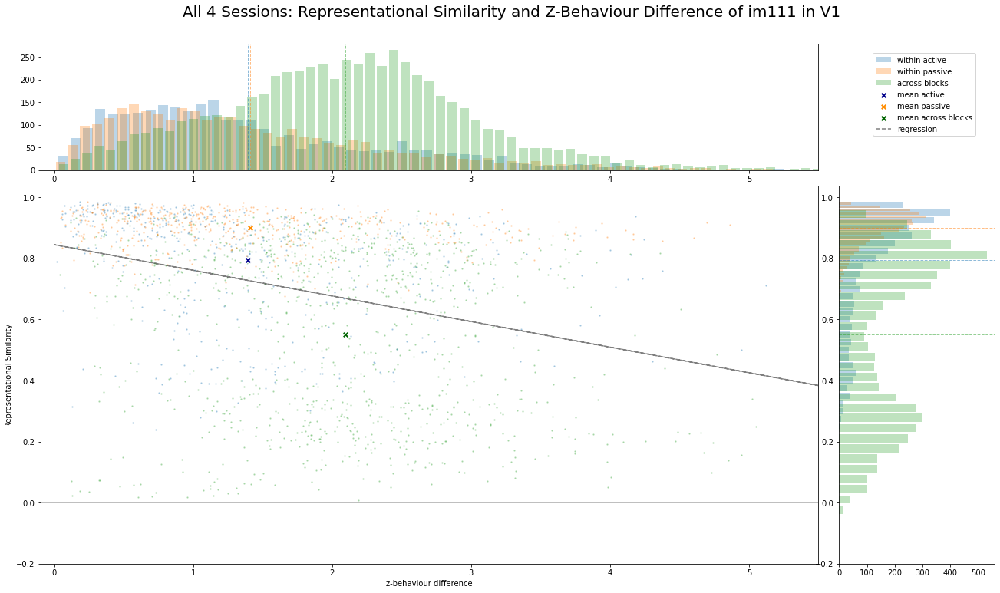

In [154]:
xa, ya, xp, yp, xb, yb, x, y, image, structure, n = append_all_session_responses(loc_sessions)

all_sessions_by_delta_b(xa, ya, xp, yp, xb, yb, x, y, image, structure, n)

In [162]:
def all_sessions_by_novel_image(fam_data, nov_data, n, brain_structure):
    
    (fam_midx1, fam_midx2, fam_midy1, fam_midy2, fam_midy3) = fam_data
    (nov_midx1, nov_midx2, nov_midy1, nov_midy2, nov_midy3) = nov_data

    
    
    fig, ax = plt.subplots(figsize=(16, 8), dpi=360)
    fig.suptitle(t=f'All Sessions: Representational Similarity over Time by Novelty in {brain_structure} - {n} sessions', fontsize=20)

    ax.plot(fam_midx1, fam_midy1, '--', c='lightseagreen', label='familiar image')
    ax.plot(fam_midx2, fam_midy3, '--', c='lightseagreen')
    ax.plot(fam_midx2, fam_midy2, '--', c='lightseagreen', alpha=0.5)
    
    ax.plot(nov_midx1, nov_midy1, '--', c='lightcoral', label='novel image')
    ax.plot(nov_midx2, nov_midy3, '--', c='lightcoral')
    ax.plot(nov_midx2, nov_midy2, '--', c='lightcoral', alpha=0.5)

    ax.set_xlabel('time in seconds   -   complete session (2.5h)') 
    ax.set_ylabel('Representational Similarity')
    ax.legend()
    ax.grid()
    
    plt.savefig(f'plots/all_sessions_rs_by_novelty.png')

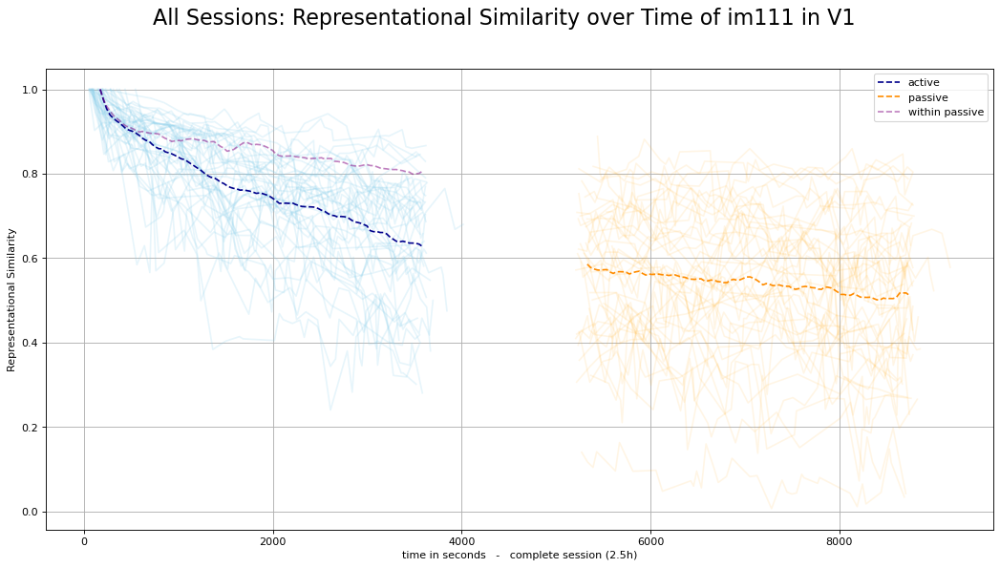

In [266]:
x1, x2, y1, y2, y3, i, u, n = conflate_all_session_responses(novel_sessions, 0) # for V1 familiar
fam_data = make_mean_curve(x1, x2, y1, y2, y3, i, u, n)

# x1, x2, y1, y2, y3, i, u, n = conflate_all_session_task_related(novel_sessions, 0) # for V1 novel 
# nov_data = make_mean_curve(x1, x2, y1, y2, y3, i, u, n)
# 
# all_sessions_by_novel_image(fam_data, nov_data, n, u)

### extended loop with download and delete

In [28]:
import shutil

def delete_session_from_cache(sessionID):
    path = f"/Users/kiracordes/allenSDK/VBNcache/visual-behavior-neuropixels-0.4.0/behavior_ecephys_sessions/{sessionID}"
    shutil.rmtree(path)
    print(f'deleted session {sessionID} from system')
    

In [29]:
def all_sessions_clean(sessions):
    
    session_data = []
    for sessionID in sessions:
        print(f"--loading session {sessionID}")
        session = get_session(session_id=sessionID)
        mouse_id = session.metadata['mouse_id']

        print('--loading tables and units')
        # tables:
        stimulus_presentations = session.stimulus_presentations
        units = session.get_units()
        units.head()
        channels = session.get_channels()
        channels.head(3)
        units = units.merge(channels, left_on='peak_channel_id', right_index=True)
        trials = session.trials
        change_trials = trials[trials.is_change]
        spike_times = session.spike_times
        running_speed = session.running_speed
        eye_tracking = session.eye_tracking
        rewards = session.rewards

        # units:
        # Filter units by the quality criteria
        good_units = units[(units['quality']=='good') &
                           (units['firing_rate']>1) &
                           (units['snr']>1) &
                           (units['isi_violations']<1)]

        good_VISp_units = good_units[good_units['structure_acronym']=='VISp']
        good_CA1_units = good_units[good_units['structure_acronym']=='CA1']
        good_VIS_units = good_units[good_units['structure_acronym'].str.contains('VIS')]
        good_VISpm_units = good_units[good_units['structure_acronym'] == 'VISpm']
        all_VISp_units = good_units[good_units['structure_acronym'].str.contains('VISp')]
        good_non_VISp_units = good_units[good_units['structure_acronym']!='VISp']
        good_VIS_without_VISp_units = good_non_VISp_units[good_non_VISp_units['structure_acronym'].str.contains('VIS')]
        assert len(good_VIS_units) == (len(good_VIS_without_VISp_units)+len(good_VISp_units))
        
        cells = False
        # tagged units:
        if 'Sst' in session.metadata['full_genotype']:
            gen_type = 'Sst'
            cells = True
        elif 'Vip' in session.metadata['full_genotype']:
            gen_type = 'Vip'
            cells = True
        else:
            gen_type = 'wt'  
            
        if cells:
            print('--checking optotagging')
            cre_pos_units_from_function = get_cre_pos_unit_ids_from_optotagging(session, structure_acronym='VIS')
            marked_VIS_units = cre_pos_units_from_function.flatten()
            VIS_units_tagged = good_units.loc[marked_VIS_units]
            VIS_units_no_tag = good_VIS_units[~good_VIS_units.index.isin(marked_VIS_units)]
            assert len(VIS_units_no_tag) == len(good_VIS_units) - len(marked_VIS_units)
            M_marked_VIS = construct_unit_activity_population_response_matrix(VIS_units_tagged, spike_times, stimulus_presentations)
            M_VIS_no_tag = construct_unit_activity_population_response_matrix(VIS_units_no_tag, spike_times, stimulus_presentations)

        print('--getting Matrices')
        # Unit Activity Matrices
        # M_all_good = construct_unit_activity_population_response_matrix(good_units, spike_times, stimulus_presentations)
        print('--for VIS')
        M_good_VIS = construct_unit_activity_population_response_matrix(good_VIS_units, spike_times, stimulus_presentations)
        print('--for VISp')
        M_good_VISp = construct_unit_activity_population_response_matrix(good_VISp_units, spike_times, stimulus_presentations)
        print('--for VIS ohne VISp')        
        M_good_VIS_excld_VISp = construct_unit_activity_population_response_matrix(good_VIS_without_VISp_units, spike_times, stimulus_presentations)
        print('--for CA')        
        M_good_CA1 = construct_unit_activity_population_response_matrix(good_CA1_units, spike_times, stimulus_presentations)

        novel=False
        if ecephys_sessions_table.loc[sessionID].experience_level == 'Novel':
            if ecephys_sessions_table.loc[sessionID].image_set == 'H':
                novel = True
        
        sex = ecephys_sessions_table.loc[sessionID].sex

        print('--create session Object')
        s0 = Sess(sessionID, mouse_id, novel, gen_type, sex, M_good_VIS, M_good_VISp, M_good_VIS_excld_VISp, M_good_CA1)
        s0.info()
        s0.basic_repr_similarity(image='im111_r', M=M_good_VISp, unit_name='V1', sp=stimulus_presentations)
        s0.basic_repr_similarity(image='im111_r', M=M_good_VIS_excld_VISp, unit_name='VIS without V1', sp=stimulus_presentations)
        s0.basic_repr_similarity(image='im111_r', M=M_good_CA1, unit_name='CA1', sp=stimulus_presentations)
        
        # behaviour related
        s0.behaviour_repr_similarity(image='im111_r', M=M_good_VISp, unit_name='V1', sp=stimulus_presentations, run_speed=running_speed, eye_track=eye_tracking)
        s0.behaviour_repr_similarity(image='im111_r', M=M_good_VIS_excld_VISp, unit_name='VIS without V1', sp=stimulus_presentations, run_speed=running_speed, eye_track=eye_tracking)
        s0.behaviour_repr_similarity(image='im111_r', M=M_good_CA1, unit_name='CA1', sp=stimulus_presentations, run_speed=running_speed, eye_track=eye_tracking)
        
        if novel:
            # get novel image to compare with familiar
            s0.novel_repr_similarity(image='im114_r', M=M_good_VISp, unit_name='V1', sp=stimulus_presentations)
            s0.novel_repr_similarity(image='im114_r', M=M_good_VIS_excld_VISp, unit_name='VIS without V1', sp=stimulus_presentations)
            s0.novel_repr_similarity(image='im114_r', M=M_good_CA1, unit_name='CA1', sp=stimulus_presentations)
        
        if cells:
            s0.basic_repr_similarity(image='im111_r', M=M_marked_VIS, unit_name='inhibitory', sp=stimulus_presentations)
            s0.basic_repr_similarity(image='im111_r', M=M_VIS_no_tag, unit_name='exhibitory', sp=stimulus_presentations)
        
        session_data.append(s0)

        print(f'session {sessionID} completed--')
        
        delete_session_from_cache(sessionID)
    
    return session_data

### test for general loop with 5 sessions

In [237]:
ecephys_sessions_table.sample(5) # changing!

,behavior_session_id,date_of_acquisition,equipment_name,session_type,mouse_id,genotype,sex,project_code,age_in_days,unit_count,...,channel_count,structure_acronyms,image_set,prior_exposures_to_image_set,session_number,experience_level,prior_exposures_to_omissions,file_id,abnormal_histology,abnormal_activity
ecephys_session_id,,,,,,,,,,,,,,,,,,,,,
1086200042,1086220230,2021-02-24 14:33:38.933000+00:00,NP.1,EPHYS_1_images_G_3uL_reward,554013,Sst-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt,F,NeuropixelVisualBehavior,156,1485.0,...,1920.0,"['APN', 'CA1', 'CA3', 'DG-mo', 'DG-po', 'DG-sg...",G,18.0,1,Familiar,0,943,NaN,NaN
1099598937,1099625106,2021-04-28 13:41:43.554000+00:00,NP.0,EPHYS_1_images_H_3uL_reward,560962,wt/wt,M,NeuropixelVisualBehavior,166,2888.0,...,2304.0,"['grey', 'root', 'VISal', 'VISam', 'VISl', 'VI...",H,17.0,1,Familiar,0,966,NaN,NaN
1092283837,1092312238,2021-03-24 15:47:12.529000+00:00,NP.0,EPHYS_1_images_G_3uL_reward,560771,Vip-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt,M,NeuropixelVisualBehavior,132,2732.0,...,2304.0,"['APN', 'CA1', 'CA3', 'DG-mo', 'DG-po', 'DG-sg...",G,23.0,1,Familiar,0,954,NaN,NaN
1118512505,1118600316,2021-07-29 13:18:24.439000+00:00,NP.1,EPHYS_1_images_G_3uL_reward,576324,wt/wt,F,NeuropixelVisualBehavior,139,1638.0,...,2304.0,"['APN', 'CA1', 'DG-mo', 'DG-po', 'DG-sg', 'HPF...",G,0.0,2,Novel,1,1003,NaN,NaN
1093864136,1093938328,2021-04-01 14:43:52.154000+00:00,NP.1,EPHYS_1_images_H_3uL_reward,553253,Vip-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt,F,NeuropixelVisualBehavior,197,2202.0,...,2304.0,"['CA1', 'CA3', 'DG-mo', 'DG-po', 'DG-sg', 'gre...",H,0.0,2,Novel,1,958,NaN,NaN


In [46]:
# loop through five new sessions to test download-analyse-delete process
session_ids = [1152632711, 1048189115, 1064644573, 1044385384, 1092283837]
sessions = all_sessions_clean(session_ids)

--loading session 1152632711


ecephys_session_1152632711.nwb: 100%|█████| 1.81G/1.81G [02:27<00:00, 12.3MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1152632711 of mouse 599294 with type Vip and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1152632711 completed--
deleted session 1152632711 from system
--loading session 1048189115


ecephys_session_1048189115.nwb: 100%|█████| 2.76G/2.76G [03:36<00:00, 12.7MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1048189115 of mouse 509808 with type Sst and sex M, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1048189115 completed--
deleted session 1048189115 from system
--loading session 1064644573


ecephys_session_1064644573.nwb: 100%|█████| 2.99G/2.99G [03:55<00:00, 12.7MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1064644573 of mouse 544456 with type Sst and sex M, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1064644573 completed--
deleted session 1064644573 from system
--loading session 1044385384


ecephys_session_1044385384.nwb: 100%|█████| 2.65G/2.65G [03:28<00:00, 12.7MMB/s]
/Users/kiracordes/opt/anaconda3/lib/python3.7/site-packages/allensdk/brain_observatory/behavior/data_objects/metadata/subject_metadata/full_genotype.py:57: UserWarning: Unable to parse cre_line from full_genotype
  warnings.warn('Unable to parse cre_line from full_genotype')


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1044385384 of mouse 524761 with type wt and sex F, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
session 1044385384 completed--
deleted session 1044385384 from system
--loading session 1092283837


ecephys_session_1092283837.nwb: 100%|█████| 3.82G/3.82G [05:05<00:00, 12.5MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1092283837 of mouse 560771 with type Vip and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1092283837 completed--
deleted session 1092283837 from system


### join loaded session objects

In [47]:
print(len(loc_sessions), len(sessions), len(loc_session_ids), len(session_ids), type(loc_sessions))
loc_sessions[0].info()
loc_sessions[1].info()
loc_sessions[2].info()
loc_sessions[3].info()
# joined_sessions = [loc_sessions[0], loc_sessions[1], loc_sessions[2], loc_sessions[3], sessions[0], sessions[1], sessions[2], sessions[3], sessions[4]]
joined_sessions = loc_sessions + sessions
len(joined_sessions), joined_sessions[6].info()

4 5 4 5 <class 'list'>
Hello I'm session 1053941483 of mouse 527749 with type Sst and sex M, novel=True
Hello I'm session 1053718935 of mouse 527749 with type Sst and sex M, novel=False
Hello I'm session 1124285719 of mouse 577287 with type Sst and sex F, novel=True
Hello I'm session 1111013640 of mouse 568963 with type Vip and sex M, novel=False
Hello I'm session 1064644573 of mouse 544456 with type Sst and sex M, novel=True


(9, None)

In [48]:
joined_sessions[-1].info()
joined_sessions[8].info()

Hello I'm session 1092283837 of mouse 560771 with type Vip and sex M, novel=False
Hello I'm session 1092283837 of mouse 560771 with type Vip and sex M, novel=False


In [49]:
# 9 sessions are already loaded, first 4 are saved locally and the rest is deleted from system
loaded_sessions_ids = [1053941483, 1053718935, 1124285719, 1111013640, 1152632711, 1048189115, 1064644573, 1044385384, 1092283837]


In [32]:
ecephys_sessions_table.head(5)

,behavior_session_id,date_of_acquisition,equipment_name,session_type,mouse_id,genotype,sex,project_code,age_in_days,unit_count,...,channel_count,structure_acronyms,image_set,prior_exposures_to_image_set,session_number,experience_level,prior_exposures_to_omissions,file_id,abnormal_histology,abnormal_activity
ecephys_session_id,,,,,,,,,,,,,,,,,,,,,
1044385384,1044408432,2020-08-19 14:47:08.574000+00:00,NP.1,EPHYS_1_images_G_5uL_reward,524761,wt/wt,F,NeuropixelVisualBehavior,151,2179.0,...,1920.0,"['CA1', 'CA3', 'DG-mo', 'DG-po', 'DG-sg', 'LGv...",G,30.0,1,Familiar,0,870,NaN,NaN
1044594870,1044624428,2020-08-20 15:03:56.422000+00:00,NP.1,EPHYS_1_images_H_5uL_reward,524761,wt/wt,F,NeuropixelVisualBehavior,152,2103.0,...,1920.0,"['CA1', 'CA3', 'DG-mo', 'DG-po', 'DG-sg', 'HPF...",H,0.0,2,Novel,1,872,NaN,NaN
1047969464,1048005547,2020-09-02 14:53:14.347000+00:00,NP.1,EPHYS_1_images_G_3uL_reward,509808,Sst-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt,M,NeuropixelVisualBehavior,263,2438.0,...,2304.0,"['APN', 'CA1', 'CA3', 'DG-mo', 'DG-po', 'DG-sg...",G,62.0,1,Familiar,0,877,NaN,NaN
1047977240,1048009327,2020-09-02 15:15:03.733000+00:00,NP.0,EPHYS_1_images_G_3uL_reward,524925,Sst-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt,F,NeuropixelVisualBehavior,165,1856.0,...,2304.0,"['APN', 'CA1', 'CA3', 'DG-mo', 'DG-po', 'DG-sg...",G,51.0,1,Familiar,0,878,NaN,NaN
1048189115,1048221709,2020-09-03 14:16:57.913000+00:00,NP.1,EPHYS_1_images_H_3uL_reward,509808,Sst-IRES-Cre/wt;Ai32(RCL-ChR2(H134R)_EYFP)/wt,M,NeuropixelVisualBehavior,264,1925.0,...,2304.0,"['APN', 'CA1', 'CA3', 'DG-mo', 'DG-po', 'DG-sg...",H,0.0,2,Novel,1,879,NaN,NaN


In [33]:
all_session_ids = ecephys_sessions_table.index
rest_sessions = [i for i in all_session_ids if i not in loaded_sessions_ids]
len(ecephys_sessions_table.index), len(loaded_sessions_ids), len(rest_sessions)

(103, 9, 94)

# Complete Loop

### download loop

In [34]:
len(rest_sessions[1:]), len(rest_sessions) # first is downloaded so will be skipped for now

(93, 94)

In [36]:
tqdm._instances.clear()
completing_sessions = all_sessions_clean(rest_sessions)

--loading session 1044594870


/Users/kiracordes/opt/anaconda3/lib/python3.7/site-packages/allensdk/brain_observatory/behavior/data_objects/metadata/subject_metadata/full_genotype.py:57: UserWarning: Unable to parse cre_line from full_genotype
  warnings.warn('Unable to parse cre_line from full_genotype')


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1044594870 of mouse 524761 with type wt and sex F, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
session 1044594870 completed--
deleted session 1044594870 from system
--loading session 1047969464


ecephys_session_1047969464.nwb: 100%|█████| 3.20G/3.20G [04:13<00:00, 12.6MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1047969464 of mouse 509808 with type Sst and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1047969464 completed--
deleted session 1047969464 from system
--loading session 1047977240


ecephys_session_1047977240.nwb: 100%|█████| 2.61G/2.61G [03:24<00:00, 12.8MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1047977240 of mouse 524925 with type Sst and sex F, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1047977240 completed--
deleted session 1047977240 from system
--loading session 1048196054


ecephys_session_1048196054.nwb: 100%|█████| 3.10G/3.10G [04:02<00:00, 12.8MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1048196054 of mouse 524925 with type Sst and sex F, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
adding inhibitory data for im111_r...


/Users/kiracordes/opt/anaconda3/lib/python3.7/site-packages/numpy/lib/function_base.py:2683: RuntimeWarning: Degrees of freedom <= 0 for slice
  c = cov(x, y, rowvar, dtype=dtype)
/Users/kiracordes/opt/anaconda3/lib/python3.7/site-packages/numpy/lib/function_base.py:2542: RuntimeWarning: divide by zero encountered in true_divide
  c *= np.true_divide(1, fact)
/Users/kiracordes/opt/anaconda3/lib/python3.7/site-packages/numpy/lib/function_base.py:2542: RuntimeWarning: invalid value encountered in multiply
  c *= np.true_divide(1, fact)


adding exhibitory data for im111_r...
session 1048196054 completed--
deleted session 1048196054 from system
--loading session 1049273528


ecephys_session_1049273528.nwb: 100%|█████| 2.98G/2.98G [03:53<00:00, 12.7MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1049273528 of mouse 521466 with type Vip and sex F, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1049273528 completed--
deleted session 1049273528 from system
--loading session 1049514117


ecephys_session_1049514117.nwb: 100%|█████| 2.80G/2.80G [04:02<00:00, 11.5MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1049514117 of mouse 521466 with type Vip and sex F, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
adding inhibitory data for im111_r...


/Users/kiracordes/opt/anaconda3/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
/Users/kiracordes/opt/anaconda3/lib/python3.7/site-packages/numpy/core/_methods.py:182: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


adding exhibitory data for im111_r...
session 1049514117 completed--
deleted session 1049514117 from system
--loading session 1051155866


ecephys_session_1051155866.nwb: 100%|█████| 3.03G/3.03G [04:09<00:00, 12.1MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1051155866 of mouse 524760 with type wt and sex F, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
session 1051155866 completed--
deleted session 1051155866 from system
--loading session 1052342277


ecephys_session_1052342277.nwb: 100%|█████| 2.40G/2.40G [03:08<00:00, 12.7MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1052342277 of mouse 530862 with type Vip and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1052342277 completed--
deleted session 1052342277 from system
--loading session 1052533639


ecephys_session_1052533639.nwb: 100%|█████| 2.31G/2.31G [03:01<00:00, 12.7MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1052533639 of mouse 530862 with type Vip and sex M, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1052533639 completed--
deleted session 1052533639 from system
--loading session 1053709239


ecephys_session_1053709239.nwb: 100%|█████| 3.71G/3.71G [04:59<00:00, 12.4MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1053709239 of mouse 532246 with type Vip and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1053709239 completed--
deleted session 1053709239 from system
--loading session 1053925378


ecephys_session_1053925378.nwb: 100%|█████| 2.73G/2.73G [03:35<00:00, 12.7MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1053925378 of mouse 532246 with type Vip and sex M, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1053925378 completed--
deleted session 1053925378 from system
--loading session 1055221968


ecephys_session_1055221968.nwb: 100%|█████| 3.37G/3.37G [04:36<00:00, 12.2MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1055221968 of mouse 533537 with type wt and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
session 1055221968 completed--
deleted session 1055221968 from system
--loading session 1055240613


ecephys_session_1055240613.nwb: 100%|█████| 2.99G/2.99G [03:54<00:00, 12.8MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1055240613 of mouse 533539 with type wt and sex F, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
session 1055240613 completed--
deleted session 1055240613 from system
--loading session 1055403683


ecephys_session_1055403683.nwb: 100%|█████| 2.16G/2.16G [02:49<00:00, 12.7MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1055403683 of mouse 533537 with type wt and sex M, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
session 1055403683 completed--
deleted session 1055403683 from system
--loading session 1055415082


ecephys_session_1055415082.nwb: 100%|█████| 2.23G/2.23G [02:56<00:00, 12.6MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1055415082 of mouse 533539 with type wt and sex F, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
session 1055415082 completed--
deleted session 1055415082 from system
--loading session 1062755779


ecephys_session_1062755779.nwb: 100%|█████| 3.41G/3.41G [04:26<00:00, 12.8MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1062755779 of mouse 541234 with type wt and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
session 1062755779 completed--
deleted session 1062755779 from system
--loading session 1063010385


ecephys_session_1063010385.nwb: 100%|█████| 2.39G/2.39G [03:09<00:00, 12.6MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1063010385 of mouse 541234 with type wt and sex M, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
session 1063010385 completed--
deleted session 1063010385 from system
--loading session 1064400234


ecephys_session_1064400234.nwb: 100%|█████| 2.71G/2.71G [03:31<00:00, 12.8MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1064400234 of mouse 544456 with type Sst and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1064400234 completed--
deleted session 1064400234 from system
--loading session 1064415305


ecephys_session_1064415305.nwb: 100%|█████| 3.49G/3.49G [04:34<00:00, 12.7MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1064415305 of mouse 536480 with type Vip and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1064415305 completed--
deleted session 1064415305 from system
--loading session 1064639378


ecephys_session_1064639378.nwb: 100%|█████| 3.36G/3.36G [04:22<00:00, 12.8MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1064639378 of mouse 536480 with type Vip and sex M, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1064639378 completed--
deleted session 1064639378 from system
--loading session 1065437523


ecephys_session_1065437523.nwb: 100%|█████| 3.20G/3.20G [04:11<00:00, 12.7MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1065437523 of mouse 544358 with type Sst and sex F, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1065437523 completed--
deleted session 1065437523 from system
--loading session 1065449881
--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1065449881 of mouse 544838 with type wt and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 d

ecephys_session_1065905010.nwb: 100%|█████| 2.72G/2.72G [03:33<00:00, 12.7MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1065905010 of mouse 544358 with type Sst and sex F, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1065905010 completed--
deleted session 1065905010 from system
--loading session 1065908084


ecephys_session_1065908084.nwb: 100%|█████| 2.86G/2.86G [04:01<00:00, 11.8MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1065908084 of mouse 544838 with type wt and sex M, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
session 1065908084 completed--
deleted session 1065908084 from system
--loading session 1067588044


ecephys_session_1067588044.nwb: 100%|█████| 3.28G/3.28G [04:18<00:00, 12.7MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1067588044 of mouse 544836 with type wt and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
session 1067588044 completed--
deleted session 1067588044 from system
--loading session 1067781390


ecephys_session_1067781390.nwb: 100%|█████| 2.82G/2.82G [03:43<00:00, 12.6MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1067781390 of mouse 544836 with type wt and sex M, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
session 1067781390 completed--
deleted session 1067781390 from system
--loading session 1069461581


ecephys_session_1069461581.nwb: 100%|█████| 2.47G/2.47G [03:14<00:00, 12.7MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1069461581 of mouse 545994 with type Sst and sex M, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1069461581 completed--
deleted session 1069461581 from system
--loading session 1071300149


ecephys_session_1071300149.nwb: 100%|█████| 2.18G/2.18G [02:50<00:00, 12.8MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1071300149 of mouse 548465 with type wt and sex M, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
session 1071300149 completed--
deleted session 1071300149 from system
--loading session 1081079981


ecephys_session_1081079981.nwb: 100%|█████| 3.08G/3.08G [04:00<00:00, 12.8MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1081079981 of mouse 548720 with type wt and sex F, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
session 1081079981 completed--
deleted session 1081079981 from system
--loading session 1081090969


ecephys_session_1081090969.nwb: 100%|█████| 3.04G/3.04G [04:00<00:00, 12.7MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1081090969 of mouse 548721 with type wt and sex F, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
session 1081090969 completed--
deleted session 1081090969 from system
--loading session 1081429294


ecephys_session_1081429294.nwb: 100%|█████| 2.69G/2.69G [03:31<00:00, 12.8MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1081429294 of mouse 548720 with type wt and sex F, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
session 1081429294 completed--
deleted session 1081429294 from system
--loading session 1081431006


ecephys_session_1081431006.nwb: 100%|█████| 2.94G/2.94G [03:49<00:00, 12.8MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1081431006 of mouse 548721 with type wt and sex F, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
session 1081431006 completed--
deleted session 1081431006 from system
--loading session 1086200042


ecephys_session_1086200042.nwb: 100%|█████| 2.07G/2.07G [02:43<00:00, 12.7MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1086200042 of mouse 554013 with type Sst and sex F, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1086200042 completed--
deleted session 1086200042 from system
--loading session 1086410738


ecephys_session_1086410738.nwb: 100%|█████| 2.28G/2.28G [02:59<00:00, 12.7MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1086410738 of mouse 554013 with type Sst and sex F, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1086410738 completed--
deleted session 1086410738 from system
--loading session 1087720624


ecephys_session_1087720624.nwb: 100%|█████| 3.22G/3.22G [04:13<00:00, 12.7MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1087720624 of mouse 556014 with type Sst and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1087720624 completed--
deleted session 1087720624 from system
--loading session 1087992708


ecephys_session_1087992708.nwb: 100%|█████| 3.23G/3.23G [04:12<00:00, 12.8MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1087992708 of mouse 556014 with type Sst and sex M, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1087992708 completed--
deleted session 1087992708 from system
--loading session 1089296550


ecephys_session_1089296550.nwb: 100%|█████| 4.08G/4.08G [05:19<00:00, 12.8MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1089296550 of mouse 556016 with type Sst and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1089296550 completed--
deleted session 1089296550 from system
--loading session 1090803859


ecephys_session_1090803859.nwb: 100%|█████| 3.47G/3.47G [04:35<00:00, 12.6MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1090803859 of mouse 553960 with type Vip and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1090803859 completed--
deleted session 1090803859 from system
--loading session 1091039376


ecephys_session_1091039376.nwb: 100%|█████| 2.67G/2.67G [03:30<00:00, 12.7MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1091039376 of mouse 553960 with type Vip and sex M, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1091039376 completed--
deleted session 1091039376 from system
--loading session 1091039902


ecephys_session_1091039902.nwb: 100%|█████| 3.14G/3.14G [04:06<00:00, 12.7MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1091039902 of mouse 555304 with type Vip and sex M, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1091039902 completed--
deleted session 1091039902 from system
--loading session 1092466205


ecephys_session_1092466205.nwb: 100%|█████| 3.48G/3.48G [04:33<00:00, 12.7MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1092466205 of mouse 560771 with type Vip and sex M, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1092466205 completed--
deleted session 1092466205 from system
--loading session 1093638203


ecephys_session_1093638203.nwb: 100%|█████| 4.06G/4.06G [05:19<00:00, 12.7MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1093638203 of mouse 560356 with type Sst and sex F, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1093638203 completed--
deleted session 1093638203 from system
--loading session 1093642839


ecephys_session_1093642839.nwb: 100%|█████| 2.44G/2.44G [03:24<00:00, 11.9MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1093642839 of mouse 553253 with type Vip and sex F, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1093642839 completed--
deleted session 1093642839 from system
--loading session 1093864136


ecephys_session_1093864136.nwb: 100%|█████| 2.84G/2.84G [03:44<00:00, 12.7MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1093864136 of mouse 553253 with type Vip and sex F, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data


/Users/kiracordes/opt/anaconda3/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3441: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/kiracordes/opt/anaconda3/lib/python3.7/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/kiracordes/opt/anaconda3/lib/python3.7/site-packages/numpy/core/_methods.py:263: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims, where=where)
/Users/kiracordes/opt/anaconda3/lib/python3.7/site-packages/numpy/core/_methods.py:223: RuntimeWarning: invalid value encountered in true_divide
  subok=False)
/Users/kiracordes/opt/anaconda3/lib/python3.7/site-packages/numpy/core/_methods.py:254: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1093864136 completed--
deleted session 1093864136 from system
--loading session 1093867806


ecephys_session_1093867806.nwb: 100%|█████| 2.77G/2.77G [03:37<00:00, 12.7MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1093867806 of mouse 560356 with type Sst and sex F, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1093867806 completed--
deleted session 1093867806 from system
--loading session 1095138995


ecephys_session_1095138995.nwb: 100%|█████| 3.34G/3.34G [04:22<00:00, 12.7MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1095138995 of mouse 558306 with type Sst and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1095138995 completed--
deleted session 1095138995 from system
--loading session 1095340643


ecephys_session_1095340643.nwb: 100%|█████| 2.58G/2.58G [03:25<00:00, 12.6MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1095340643 of mouse 558306 with type Sst and sex M, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1095340643 completed--
deleted session 1095340643 from system
--loading session 1096620314


ecephys_session_1096620314.nwb: 100%|█████| 3.66G/3.66G [04:55<00:00, 12.4MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1096620314 of mouse 560770 with type Vip and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1096620314 completed--
deleted session 1096620314 from system
--loading session 1096935816


ecephys_session_1096935816.nwb: 100%|█████| 2.43G/2.43G [03:12<00:00, 12.6MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1096935816 of mouse 560770 with type Vip and sex M, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1096935816 completed--
deleted session 1096935816 from system
--loading session 1098119201


ecephys_session_1098119201.nwb: 100%|█████| 3.44G/3.44G [04:30<00:00, 12.7MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1098119201 of mouse 563323 with type Sst and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1098119201 completed--
deleted session 1098119201 from system
--loading session 1099598937


ecephys_session_1099598937.nwb: 100%|█████| 3.76G/3.76G [04:57<00:00, 12.7MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1099598937 of mouse 560962 with type wt and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
session 1099598937 completed--
deleted session 1099598937 from system
--loading session 1099869737


ecephys_session_1099869737.nwb: 100%|█████| 2.64G/2.64G [03:35<00:00, 12.2MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1099869737 of mouse 560962 with type wt and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
session 1099869737 completed--
deleted session 1099869737 from system
--loading session 1104052767


ecephys_session_1104052767.nwb: 100%|█████| 2.97G/2.97G [04:04<00:00, 12.1MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1104052767 of mouse 560964 with type wt and sex F, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
session 1104052767 completed--
deleted session 1104052767 from system
--loading session 1104058216


ecephys_session_1104058216.nwb: 100%|█████| 1.64G/1.64G [02:10<00:00, 12.6MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1104058216 of mouse 563497 with type Sst and sex F, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1104058216 completed--
deleted session 1104058216 from system
--loading session 1104289498


ecephys_session_1104289498.nwb: 100%|█████| 1.40G/1.40G [02:00<00:00, 11.7MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1104289498 of mouse 563497 with type Sst and sex F, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1104289498 completed--
deleted session 1104289498 from system
--loading session 1104297538


ecephys_session_1104297538.nwb: 100%|█████| 3.13G/3.13G [04:06<00:00, 12.7MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1104297538 of mouse 560964 with type wt and sex F, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
session 1104297538 completed--
deleted session 1104297538 from system
--loading session 1105543760


ecephys_session_1105543760.nwb: 100%|█████| 1.72G/1.72G [02:15<00:00, 12.7MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1105543760 of mouse 567286 with type Sst and sex F, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1105543760 completed--
deleted session 1105543760 from system
--loading session 1105798776


ecephys_session_1105798776.nwb: 100%|█████| 1.65G/1.65G [02:10<00:00, 12.7MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1105798776 of mouse 567286 with type Sst and sex F, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1105798776 completed--
deleted session 1105798776 from system
--loading session 1108334384


ecephys_session_1108334384.nwb: 100%|█████| 2.26G/2.26G [02:58<00:00, 12.7MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1108334384 of mouse 570301 with type Sst and sex F, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1108334384 completed--
deleted session 1108334384 from system
--loading session 1108335514


ecephys_session_1108335514.nwb: 100%|█████| 2.66G/2.66G [03:30<00:00, 12.7MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1108335514 of mouse 571520 with type wt and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
session 1108335514 completed--
deleted session 1108335514 from system
--loading session 1108528422


ecephys_session_1108528422.nwb: 100%|█████| 2.19G/2.19G [03:03<00:00, 11.9MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1108528422 of mouse 571520 with type wt and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
session 1108528422 completed--
deleted session 1108528422 from system
--loading session 1108531612


ecephys_session_1108531612.nwb: 100%|█████| 1.77G/1.77G [02:19<00:00, 12.7MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1108531612 of mouse 570301 with type Sst and sex F, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1108531612 completed--
deleted session 1108531612 from system
--loading session 1109680280


ecephys_session_1109680280.nwb: 100%|█████| 1.66G/1.66G [02:10<00:00, 12.7MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1109680280 of mouse 568022 with type wt and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
session 1109680280 completed--
deleted session 1109680280 from system
--loading session 1109889304


ecephys_session_1109889304.nwb: 100%|█████| 2.65G/2.65G [03:27<00:00, 12.8MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1109889304 of mouse 568022 with type wt and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
session 1109889304 completed--
deleted session 1109889304 from system
--loading session 1111216934


ecephys_session_1111216934.nwb: 100%|█████| 2.45G/2.45G [03:13<00:00, 12.6MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1111216934 of mouse 568963 with type Vip and sex M, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1111216934 completed--
deleted session 1111216934 from system
--loading session 1112302803


ecephys_session_1112302803.nwb: 100%|█████| 3.11G/3.11G [04:19<00:00, 12.0MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1112302803 of mouse 572846 with type Sst and sex F, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1112302803 completed--
deleted session 1112302803 from system
--loading session 1112515874


ecephys_session_1112515874.nwb: 100%|█████| 2.03G/2.03G [02:41<00:00, 12.6MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1112515874 of mouse 572846 with type Sst and sex F, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1112515874 completed--
deleted session 1112515874 from system
--loading session 1115077618


ecephys_session_1115077618.nwb: 100%|█████| 2.55G/2.55G [03:20<00:00, 12.7MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1115077618 of mouse 570299 with type Sst and sex F, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1115077618 completed--
deleted session 1115077618 from system
--loading session 1115086689


ecephys_session_1115086689.nwb: 100%|█████| 3.34G/3.34G [04:22<00:00, 12.7MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1115086689 of mouse 574078 with type Sst and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1115086689 completed--
deleted session 1115086689 from system
--loading session 1090800639


ecephys_session_1090800639.nwb: 100%|█████| 3.98G/3.98G [05:14<00:00, 12.6MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1090800639 of mouse 555304 with type Vip and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1090800639 completed--
deleted session 1090800639 from system
--loading session 1115356973


ecephys_session_1115356973.nwb: 100%|█████| 2.66G/2.66G [03:28<00:00, 12.8MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1115356973 of mouse 570299 with type Sst and sex F, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1115356973 completed--
deleted session 1115356973 from system
--loading session 1115368723


ecephys_session_1115368723.nwb: 100%|█████| 2.90G/2.90G [03:48<00:00, 12.7MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1115368723 of mouse 574078 with type Sst and sex M, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1115368723 completed--
deleted session 1115368723 from system
--loading session 1116941914


ecephys_session_1116941914.nwb: 100%|█████| 2.69G/2.69G [03:33<00:00, 12.6MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1116941914 of mouse 576323 with type wt and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
session 1116941914 completed--
deleted session 1116941914 from system
--loading session 1117148442


ecephys_session_1117148442.nwb: 100%|█████| 2.39G/2.39G [03:09<00:00, 12.6MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1117148442 of mouse 576323 with type wt and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
session 1117148442 completed--
deleted session 1117148442 from system
--loading session 1118324999


ecephys_session_1118324999.nwb: 100%|█████| 2.96G/2.96G [03:52<00:00, 12.7MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1118324999 of mouse 576324 with type wt and sex F, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
session 1118324999 completed--
deleted session 1118324999 from system
--loading session 1118327332
--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1118327332 of mouse 574082 with type Sst and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r

ecephys_session_1118508667.nwb: 100%|█████| 2.92G/2.92G [03:49<00:00, 12.7MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1118508667 of mouse 574082 with type Sst and sex M, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1118508667 completed--
deleted session 1118508667 from system
--loading session 1118512505


ecephys_session_1118512505.nwb: 100%|█████| 2.30G/2.30G [03:01<00:00, 12.7MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1118512505 of mouse 576324 with type wt and sex F, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
session 1118512505 completed--
deleted session 1118512505 from system
--loading session 1119946360


ecephys_session_1119946360.nwb: 100%|█████| 3.65G/3.65G [05:11<00:00, 11.7MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1119946360 of mouse 578003 with type wt and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
session 1119946360 completed--
deleted session 1119946360 from system
--loading session 1120251466


ecephys_session_1120251466.nwb: 100%|█████| 2.68G/2.68G [03:30<00:00, 12.8MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1120251466 of mouse 578003 with type wt and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
session 1120251466 completed--
deleted session 1120251466 from system
--loading session 1121406444


ecephys_session_1121406444.nwb: 100%|█████| 2.48G/2.48G [03:15<00:00, 12.7MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1121406444 of mouse 574081 with type Sst and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1121406444 completed--
deleted session 1121406444 from system
--loading session 1121607504


ecephys_session_1121607504.nwb: 100%|█████| 2.56G/2.56G [03:22<00:00, 12.6MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1121607504 of mouse 574081 with type Sst and sex M, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1121607504 completed--
deleted session 1121607504 from system
--loading session 1122903357


ecephys_session_1122903357.nwb: 100%|█████| 3.08G/3.08G [04:14<00:00, 12.1MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1122903357 of mouse 570302 with type Sst and sex F, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1122903357 completed--
deleted session 1122903357 from system
--loading session 1123100019


ecephys_session_1123100019.nwb: 100%|█████| 2.50G/2.50G [03:17<00:00, 12.6MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1123100019 of mouse 570302 with type Sst and sex F, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1123100019 completed--
deleted session 1123100019 from system
--loading session 1124507277


ecephys_session_1124507277.nwb: 100%|█████| 2.65G/2.65G [03:27<00:00, 12.7MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1124507277 of mouse 577287 with type Sst and sex F, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1124507277 completed--
deleted session 1124507277 from system
--loading session 1125713722


ecephys_session_1125713722.nwb: 100%|█████| 2.74G/2.74G [03:51<00:00, 11.8MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1125713722 of mouse 578257 with type Sst and sex F, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1125713722 completed--
deleted session 1125713722 from system
--loading session 1125937457


ecephys_session_1125937457.nwb: 100%|█████| 2.39G/2.39G [03:20<00:00, 11.9MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1125937457 of mouse 578257 with type Sst and sex F, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1125937457 completed--
deleted session 1125937457 from system
--loading session 1128520325


ecephys_session_1128520325.nwb: 100%|█████| 2.45G/2.45G [03:24<00:00, 12.0MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1128520325 of mouse 585326 with type wt and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
session 1128520325 completed--
deleted session 1128520325 from system
--loading session 1128719842


ecephys_session_1128719842.nwb: 100%|█████| 2.17G/2.17G [02:50<00:00, 12.7MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1128719842 of mouse 585326 with type wt and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
session 1128719842 completed--
deleted session 1128719842 from system
--loading session 1130113579


ecephys_session_1130113579.nwb: 100%|█████| 3.22G/3.22G [04:16<00:00, 12.6MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1130113579 of mouse 579993 with type wt and sex F, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
session 1130113579 completed--
deleted session 1130113579 from system
--loading session 1130349290


ecephys_session_1130349290.nwb: 100%|█████| 2.48G/2.48G [03:30<00:00, 11.8MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1130349290 of mouse 579993 with type wt and sex F, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
session 1130349290 completed--
deleted session 1130349290 from system
--loading session 1139846596


ecephys_session_1139846596.nwb: 100%|█████| 2.69G/2.69G [04:01<00:00, 11.1MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1139846596 of mouse 585329 with type wt and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
session 1139846596 completed--
deleted session 1139846596 from system
--loading session 1140102579


ecephys_session_1140102579.nwb: 100%|█████| 2.73G/2.73G [03:51<00:00, 11.8MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1140102579 of mouse 585329 with type wt and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
session 1140102579 completed--
deleted session 1140102579 from system
--loading session 1152811536


ecephys_session_1152811536.nwb: 100%|█████| 1.74G/1.74G [02:28<00:00, 11.7MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1152811536 of mouse 599294 with type Vip and sex M, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1152811536 completed--
deleted session 1152811536 from system


In [45]:
completing_sessions[0].info()
completing_sessions[1].info()
completing_sessions[2].info()
completing_sessions[3].info()
completing_sessions[4].info()
completing_sessions[5].info()
completing_sessions[6].info()
completing_sessions[7].info()
completing_sessions[8].info()
completing_sessions[9].info()
completing_sessions[10].info()

completing_sessions[12].info()
completing_sessions[18].info()
completing_sessions[19].info()
completing_sessions[55].info()
completing_sessions[68].info()
completing_sessions[93].info() 

Hello I'm session 1044594870 of mouse 524761 with type wt and sex F, novel=True
Hello I'm session 1047969464 of mouse 509808 with type Sst and sex M, novel=False
Hello I'm session 1047977240 of mouse 524925 with type Sst and sex F, novel=False
Hello I'm session 1048196054 of mouse 524925 with type Sst and sex F, novel=True
Hello I'm session 1049273528 of mouse 521466 with type Vip and sex F, novel=False
Hello I'm session 1049514117 of mouse 521466 with type Vip and sex F, novel=True
Hello I'm session 1051155866 of mouse 524760 with type wt and sex F, novel=True
Hello I'm session 1052342277 of mouse 530862 with type Vip and sex M, novel=False
Hello I'm session 1052533639 of mouse 530862 with type Vip and sex M, novel=True
Hello I'm session 1053709239 of mouse 532246 with type Vip and sex M, novel=False
Hello I'm session 1053925378 of mouse 532246 with type Vip and sex M, novel=True
Hello I'm session 1055240613 of mouse 533539 with type wt and sex F, novel=False
Hello I'm session 1064415

In [37]:
# tqdm._instances.clear()
# completing_sessions2 = all_sessions_clean(rest_sessions[20:])

--loading session 1065437523


ecephys_session_1065437523.nwb: 100%|█████| 3.20G/3.20G [04:10<00:00, 12.8MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1065437523 of mouse 544358 with type Sst and sex F, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1065437523 completed--
deleted session 1065437523 from system
--loading session 1065449881


ecephys_session_1065449881.nwb: 100%|█████| 3.80G/3.80G [04:59<00:00, 12.7MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1065449881 of mouse 544838 with type wt and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
session 1065449881 completed--
deleted session 1065449881 from system
--loading session 1065905010


ecephys_session_1065905010.nwb: 100%|█████| 2.72G/2.72G [03:36<00:00, 12.6MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1065905010 of mouse 544358 with type Sst and sex F, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1065905010 completed--
deleted session 1065905010 from system
--loading session 1065908084


ecephys_session_1065908084.nwb: 100%|█████| 2.86G/2.86G [03:49<00:00, 12.4MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1065908084 of mouse 544838 with type wt and sex M, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
session 1065908084 completed--
deleted session 1065908084 from system
--loading session 1067588044


ecephys_session_1067588044.nwb: 100%|█████| 3.28G/3.28G [04:20<00:00, 12.6MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1067588044 of mouse 544836 with type wt and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
session 1067588044 completed--
deleted session 1067588044 from system
--loading session 1067781390


ecephys_session_1067781390.nwb: 100%|█████| 2.82G/2.82G [03:42<00:00, 12.7MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1067781390 of mouse 544836 with type wt and sex M, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
session 1067781390 completed--
deleted session 1067781390 from system
--loading session 1069461581


ecephys_session_1069461581.nwb: 100%|█████| 2.47G/2.47G [03:16<00:00, 12.6MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1069461581 of mouse 545994 with type Sst and sex M, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1069461581 completed--
deleted session 1069461581 from system
--loading session 1071300149


ecephys_session_1071300149.nwb: 100%|█████| 2.18G/2.18G [02:53<00:00, 12.6MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1071300149 of mouse 548465 with type wt and sex M, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
session 1071300149 completed--
deleted session 1071300149 from system
--loading session 1081079981


ecephys_session_1081079981.nwb: 100%|█████| 3.08G/3.08G [04:07<00:00, 12.5MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1081079981 of mouse 548720 with type wt and sex F, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
session 1081079981 completed--
deleted session 1081079981 from system
--loading session 1081090969


ecephys_session_1081090969.nwb: 100%|█████| 3.04G/3.04G [04:00<00:00, 12.7MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1081090969 of mouse 548721 with type wt and sex F, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
session 1081090969 completed--
deleted session 1081090969 from system
--loading session 1081429294


ecephys_session_1081429294.nwb: 100%|█████| 2.69G/2.69G [03:45<00:00, 12.0MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1081429294 of mouse 548720 with type wt and sex F, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
session 1081429294 completed--
deleted session 1081429294 from system
--loading session 1081431006


ecephys_session_1081431006.nwb: 100%|█████| 2.94G/2.94G [04:09<00:00, 11.8MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1081431006 of mouse 548721 with type wt and sex F, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
session 1081431006 completed--
deleted session 1081431006 from system
--loading session 1086200042


ecephys_session_1086200042.nwb: 100%|█████| 2.07G/2.07G [02:56<00:00, 11.7MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1086200042 of mouse 554013 with type Sst and sex F, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1086200042 completed--
deleted session 1086200042 from system
--loading session 1086410738


ecephys_session_1086410738.nwb: 100%|█████| 2.28G/2.28G [03:13<00:00, 11.8MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1086410738 of mouse 554013 with type Sst and sex F, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1086410738 completed--
deleted session 1086410738 from system
--loading session 1087720624


ecephys_session_1087720624.nwb: 100%|█████| 3.22G/3.22G [04:32<00:00, 11.8MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1087720624 of mouse 556014 with type Sst and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1087720624 completed--
deleted session 1087720624 from system
--loading session 1087992708


ecephys_session_1087992708.nwb: 100%|█████| 3.23G/3.23G [04:33<00:00, 11.8MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1087992708 of mouse 556014 with type Sst and sex M, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1087992708 completed--
deleted session 1087992708 from system
--loading session 1089296550


ecephys_session_1089296550.nwb: 100%|█████| 4.08G/4.08G [05:45<00:00, 11.8MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1089296550 of mouse 556016 with type Sst and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1089296550 completed--
deleted session 1089296550 from system
--loading session 1090803859


ecephys_session_1090803859.nwb: 100%|█████| 3.47G/3.47G [04:50<00:00, 11.9MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1090803859 of mouse 553960 with type Vip and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1090803859 completed--
deleted session 1090803859 from system
--loading session 1091039376


ecephys_session_1091039376.nwb: 100%|█████| 2.67G/2.67G [03:48<00:00, 11.7MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1091039376 of mouse 553960 with type Vip and sex M, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1091039376 completed--
deleted session 1091039376 from system
--loading session 1091039902


ecephys_session_1091039902.nwb: 100%|█████| 3.14G/3.14G [04:29<00:00, 11.6MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1091039902 of mouse 555304 with type Vip and sex M, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1091039902 completed--
deleted session 1091039902 from system
--loading session 1092466205


ecephys_session_1092466205.nwb: 100%|█████| 3.48G/3.48G [04:50<00:00, 12.0MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1092466205 of mouse 560771 with type Vip and sex M, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1092466205 completed--
deleted session 1092466205 from system
--loading session 1093638203


ecephys_session_1093638203.nwb: 100%|█████| 4.06G/4.06G [05:40<00:00, 11.9MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1093638203 of mouse 560356 with type Sst and sex F, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1093638203 completed--
deleted session 1093638203 from system
--loading session 1093642839


ecephys_session_1093642839.nwb: 100%|█████| 2.44G/2.44G [03:26<00:00, 11.8MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1093642839 of mouse 553253 with type Vip and sex F, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1093642839 completed--
deleted session 1093642839 from system
--loading session 1093864136


ecephys_session_1093864136.nwb: 100%|█████| 2.84G/2.84G [04:03<00:00, 11.7MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1093864136 of mouse 553253 with type Vip and sex F, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data


/Users/kiracordes/opt/anaconda3/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3441: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/kiracordes/opt/anaconda3/lib/python3.7/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/kiracordes/opt/anaconda3/lib/python3.7/site-packages/numpy/core/_methods.py:263: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims, where=where)
/Users/kiracordes/opt/anaconda3/lib/python3.7/site-packages/numpy/core/_methods.py:223: RuntimeWarning: invalid value encountered in true_divide
  subok=False)
/Users/kiracordes/opt/anaconda3/lib/python3.7/site-packages/numpy/core/_methods.py:254: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1093864136 completed--
deleted session 1093864136 from system
--loading session 1093867806


ecephys_session_1093867806.nwb: 100%|█████| 2.77G/2.77G [03:59<00:00, 11.6MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1093867806 of mouse 560356 with type Sst and sex F, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1093867806 completed--
deleted session 1093867806 from system
--loading session 1095138995


ecephys_session_1095138995.nwb: 100%|█████| 3.34G/3.34G [04:42<00:00, 11.8MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1095138995 of mouse 558306 with type Sst and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1095138995 completed--
deleted session 1095138995 from system
--loading session 1095340643


ecephys_session_1095340643.nwb: 100%|█████| 2.58G/2.58G [03:40<00:00, 11.7MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1095340643 of mouse 558306 with type Sst and sex M, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1095340643 completed--
deleted session 1095340643 from system
--loading session 1096620314


ecephys_session_1096620314.nwb: 100%|█████| 3.66G/3.66G [05:09<00:00, 11.8MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1096620314 of mouse 560770 with type Vip and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1096620314 completed--
deleted session 1096620314 from system
--loading session 1096935816


ecephys_session_1096935816.nwb: 100%|█████| 2.43G/2.43G [03:27<00:00, 11.7MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1096935816 of mouse 560770 with type Vip and sex M, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1096935816 completed--
deleted session 1096935816 from system
--loading session 1098119201


ecephys_session_1098119201.nwb: 100%|█████| 3.44G/3.44G [05:25<00:00, 10.6MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1098119201 of mouse 563323 with type Sst and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1098119201 completed--
deleted session 1098119201 from system
--loading session 1099598937


ecephys_session_1099598937.nwb: 100%|█████| 3.76G/3.76G [04:57<00:00, 12.6MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1099598937 of mouse 560962 with type wt and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
session 1099598937 completed--
deleted session 1099598937 from system
--loading session 1099869737


ecephys_session_1099869737.nwb: 100%|█████| 2.64G/2.64G [03:34<00:00, 12.3MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1099869737 of mouse 560962 with type wt and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
session 1099869737 completed--
deleted session 1099869737 from system
--loading session 1104052767


ecephys_session_1104052767.nwb: 100%|█████| 2.97G/2.97G [03:53<00:00, 12.7MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1104052767 of mouse 560964 with type wt and sex F, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
session 1104052767 completed--
deleted session 1104052767 from system
--loading session 1104058216


ecephys_session_1104058216.nwb: 100%|█████| 1.64G/1.64G [02:25<00:00, 11.2MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1104058216 of mouse 563497 with type Sst and sex F, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1104058216 completed--
deleted session 1104058216 from system
--loading session 1104289498


ecephys_session_1104289498.nwb: 100%|█████| 1.40G/1.40G [01:51<00:00, 12.6MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1104289498 of mouse 563497 with type Sst and sex F, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1104289498 completed--
deleted session 1104289498 from system
--loading session 1104297538


ecephys_session_1104297538.nwb: 100%|█████| 3.13G/3.13G [04:11<00:00, 12.4MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1104297538 of mouse 560964 with type wt and sex F, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
session 1104297538 completed--
deleted session 1104297538 from system
--loading session 1105543760


ecephys_session_1105543760.nwb: 100%|█████| 1.72G/1.72G [02:16<00:00, 12.6MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1105543760 of mouse 567286 with type Sst and sex F, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1105543760 completed--
deleted session 1105543760 from system
--loading session 1105798776


ecephys_session_1105798776.nwb: 100%|█████| 1.65G/1.65G [02:09<00:00, 12.7MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1105798776 of mouse 567286 with type Sst and sex F, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1105798776 completed--
deleted session 1105798776 from system
--loading session 1108334384


ecephys_session_1108334384.nwb: 100%|█████| 2.26G/2.26G [02:57<00:00, 12.7MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1108334384 of mouse 570301 with type Sst and sex F, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1108334384 completed--
deleted session 1108334384 from system
--loading session 1108335514


ecephys_session_1108335514.nwb: 100%|█████| 2.66G/2.66G [03:29<00:00, 12.7MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1108335514 of mouse 571520 with type wt and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
session 1108335514 completed--
deleted session 1108335514 from system
--loading session 1108528422


ecephys_session_1108528422.nwb: 100%|█████| 2.19G/2.19G [02:53<00:00, 12.7MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1108528422 of mouse 571520 with type wt and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
session 1108528422 completed--
deleted session 1108528422 from system
--loading session 1108531612


ecephys_session_1108531612.nwb: 100%|█████| 1.77G/1.77G [02:19<00:00, 12.7MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1108531612 of mouse 570301 with type Sst and sex F, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1108531612 completed--
deleted session 1108531612 from system
--loading session 1109680280


ecephys_session_1109680280.nwb: 100%|█████| 1.66G/1.66G [02:10<00:00, 12.7MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1109680280 of mouse 568022 with type wt and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
session 1109680280 completed--
deleted session 1109680280 from system
--loading session 1109889304


ecephys_session_1109889304.nwb: 100%|█████| 2.65G/2.65G [03:29<00:00, 12.7MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1109889304 of mouse 568022 with type wt and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
session 1109889304 completed--
deleted session 1109889304 from system
--loading session 1111216934


ecephys_session_1111216934.nwb: 100%|█████| 2.45G/2.45G [03:11<00:00, 12.8MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1111216934 of mouse 568963 with type Vip and sex M, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1111216934 completed--
deleted session 1111216934 from system
--loading session 1112302803


ecephys_session_1112302803.nwb: 100%|█████| 3.11G/3.11G [04:08<00:00, 12.5MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1112302803 of mouse 572846 with type Sst and sex F, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1112302803 completed--
deleted session 1112302803 from system
--loading session 1112515874


ecephys_session_1112515874.nwb: 100%|█████| 2.03G/2.03G [02:43<00:00, 12.4MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1112515874 of mouse 572846 with type Sst and sex F, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1112515874 completed--
deleted session 1112515874 from system
--loading session 1115077618


ecephys_session_1115077618.nwb: 100%|█████| 2.55G/2.55G [03:38<00:00, 11.7MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1115077618 of mouse 570299 with type Sst and sex F, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1115077618 completed--
deleted session 1115077618 from system
--loading session 1115086689


ecephys_session_1115086689.nwb: 100%|█████| 3.34G/3.34G [04:25<00:00, 12.6MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1115086689 of mouse 574078 with type Sst and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1115086689 completed--
deleted session 1115086689 from system
--loading session 1090800639


ecephys_session_1090800639.nwb: 100%|█████| 3.98G/3.98G [05:15<00:00, 12.6MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1090800639 of mouse 555304 with type Vip and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1090800639 completed--
deleted session 1090800639 from system
--loading session 1115356973


ecephys_session_1115356973.nwb: 100%|█████| 2.66G/2.66G [03:31<00:00, 12.6MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1115356973 of mouse 570299 with type Sst and sex F, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1115356973 completed--
deleted session 1115356973 from system
--loading session 1115368723


ecephys_session_1115368723.nwb: 100%|█████| 2.90G/2.90G [03:48<00:00, 12.7MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1115368723 of mouse 574078 with type Sst and sex M, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1115368723 completed--
deleted session 1115368723 from system
--loading session 1116941914


ecephys_session_1116941914.nwb: 100%|█████| 2.69G/2.69G [03:34<00:00, 12.5MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1116941914 of mouse 576323 with type wt and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
session 1116941914 completed--
deleted session 1116941914 from system
--loading session 1117148442


ecephys_session_1117148442.nwb: 100%|█████| 2.39G/2.39G [03:08<00:00, 12.7MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1117148442 of mouse 576323 with type wt and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
session 1117148442 completed--
deleted session 1117148442 from system
--loading session 1118324999


ecephys_session_1118324999.nwb: 100%|█████| 2.96G/2.96G [03:53<00:00, 12.7MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1118324999 of mouse 576324 with type wt and sex F, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
session 1118324999 completed--
deleted session 1118324999 from system
--loading session 1118327332


ecephys_session_1118327332.nwb: 100%|█████| 2.66G/2.66G [03:28<00:00, 12.7MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1118327332 of mouse 574082 with type Sst and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1118327332 completed--
deleted session 1118327332 from system
--loading session 1118508667


ecephys_session_1118508667.nwb: 100%|█████| 2.92G/2.92G [03:52<00:00, 12.6MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1118508667 of mouse 574082 with type Sst and sex M, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1118508667 completed--
deleted session 1118508667 from system
--loading session 1118512505


ecephys_session_1118512505.nwb: 100%|█████| 2.30G/2.30G [03:00<00:00, 12.7MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1118512505 of mouse 576324 with type wt and sex F, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
session 1118512505 completed--
deleted session 1118512505 from system
--loading session 1119946360


ecephys_session_1119946360.nwb: 100%|█████| 3.65G/3.65G [04:48<00:00, 12.7MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1119946360 of mouse 578003 with type wt and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
session 1119946360 completed--
deleted session 1119946360 from system
--loading session 1120251466


ecephys_session_1120251466.nwb: 100%|█████| 2.68G/2.68G [03:32<00:00, 12.6MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1120251466 of mouse 578003 with type wt and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
session 1120251466 completed--
deleted session 1120251466 from system
--loading session 1121406444


ecephys_session_1121406444.nwb: 100%|█████| 2.48G/2.48G [03:17<00:00, 12.5MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1121406444 of mouse 574081 with type Sst and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1121406444 completed--
deleted session 1121406444 from system
--loading session 1121607504


ecephys_session_1121607504.nwb: 100%|█████| 2.56G/2.56G [03:21<00:00, 12.7MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1121607504 of mouse 574081 with type Sst and sex M, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1121607504 completed--
deleted session 1121607504 from system
--loading session 1122903357


ecephys_session_1122903357.nwb: 100%|█████| 3.08G/3.08G [04:02<00:00, 12.7MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1122903357 of mouse 570302 with type Sst and sex F, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1122903357 completed--
deleted session 1122903357 from system
--loading session 1123100019


ecephys_session_1123100019.nwb: 100%|█████| 2.50G/2.50G [03:16<00:00, 12.7MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1123100019 of mouse 570302 with type Sst and sex F, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1123100019 completed--
deleted session 1123100019 from system
--loading session 1124507277


ecephys_session_1124507277.nwb: 100%|█████| 2.65G/2.65G [03:27<00:00, 12.7MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1124507277 of mouse 577287 with type Sst and sex F, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1124507277 completed--
deleted session 1124507277 from system
--loading session 1125713722


ecephys_session_1125713722.nwb: 100%|█████| 2.74G/2.74G [03:35<00:00, 12.7MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1125713722 of mouse 578257 with type Sst and sex F, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1125713722 completed--
deleted session 1125713722 from system
--loading session 1125937457


ecephys_session_1125937457.nwb: 100%|█████| 2.39G/2.39G [03:08<00:00, 12.7MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1125937457 of mouse 578257 with type Sst and sex F, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1125937457 completed--
deleted session 1125937457 from system
--loading session 1128520325


ecephys_session_1128520325.nwb: 100%|█████| 2.45G/2.45G [03:13<00:00, 12.7MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1128520325 of mouse 585326 with type wt and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
session 1128520325 completed--
deleted session 1128520325 from system
--loading session 1128719842


ecephys_session_1128719842.nwb: 100%|█████| 2.17G/2.17G [02:51<00:00, 12.6MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1128719842 of mouse 585326 with type wt and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
session 1128719842 completed--
deleted session 1128719842 from system
--loading session 1130113579


ecephys_session_1130113579.nwb: 100%|█████| 3.22G/3.22G [04:20<00:00, 12.3MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1130113579 of mouse 579993 with type wt and sex F, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
session 1130113579 completed--
deleted session 1130113579 from system
--loading session 1130349290


ecephys_session_1130349290.nwb: 100%|█████| 2.48G/2.48G [03:15<00:00, 12.7MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1130349290 of mouse 579993 with type wt and sex F, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
session 1130349290 completed--
deleted session 1130349290 from system
--loading session 1139846596


ecephys_session_1139846596.nwb: 100%|█████| 2.69G/2.69G [03:32<00:00, 12.6MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1139846596 of mouse 585329 with type wt and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
session 1139846596 completed--
deleted session 1139846596 from system
--loading session 1140102579


ecephys_session_1140102579.nwb: 100%|█████| 2.73G/2.73G [03:37<00:00, 12.5MMB/s]


--loading tables and units
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1140102579 of mouse 585329 with type wt and sex M, novel=False
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
session 1140102579 completed--
deleted session 1140102579 from system
--loading session 1152811536


ecephys_session_1152811536.nwb: 100%|█████| 1.74G/1.74G [02:16<00:00, 12.7MMB/s]


--loading tables and units
--checking optotagging
Number of trials: 150
--getting Matrices
--for VIS
--for VISp
--for VIS ohne VISp
--for CA
--create session Object
Hello I'm session 1152811536 of mouse 599294 with type Vip and sex M, novel=True
adding V1 data for im111_r...
adding VIS without V1 data for im111_r...
adding CA1 data for im111_r...
adding V1 data for im111_r... and behaviour data
adding VIS without V1 data for im111_r... and behaviour data
adding CA1 data for im111_r... and behaviour data
adding V1 data for im114_r...
adding VIS without V1 data for im114_r...
adding CA1 data for im114_r...
adding inhibitory data for im111_r...
adding exhibitory data for im111_r...
session 1152811536 completed--
deleted session 1152811536 from system


In [44]:
# completing_sessions2[0].info()
# completing_sessions2[12].info()
# completing_sessions2[18].info()
# completing_sessions2[19].info()
# completing_sessions2[30].info()
# completing_sessions2[31].info()
# completing_sessions2[57].info()
# completing_sessions2[70].info()
# completing_sessions2[72].info()
# completing_sessions2[73].info()


Hello I'm session 1065437523 of mouse 544358 with type Sst and sex F, novel=False
Hello I'm session 1086200042 of mouse 554013 with type Sst and sex F, novel=False
Hello I'm session 1091039376 of mouse 553960 with type Vip and sex M, novel=True
Hello I'm session 1091039902 of mouse 555304 with type Vip and sex M, novel=True
Hello I'm session 1099598937 of mouse 560962 with type wt and sex M, novel=False
Hello I'm session 1099869737 of mouse 560962 with type wt and sex M, novel=False
Hello I'm session 1118512505 of mouse 576324 with type wt and sex F, novel=False
Hello I'm session 1130349290 of mouse 579993 with type wt and sex F, novel=False
Hello I'm session 1140102579 of mouse 585329 with type wt and sex M, novel=False
Hello I'm session 1152811536 of mouse 599294 with type Vip and sex M, novel=True


In [50]:
# all_sessions = joined_sessions + completing_sessions + completing_sessions2
all_sessions = joined_sessions + completing_sessions

### all sessions

In [51]:
all_sessions[90].info()

Hello I'm session 1121607504 of mouse 574081 with type Sst and sex M, novel=True


In [52]:
len(all_sessions)

103

## Results

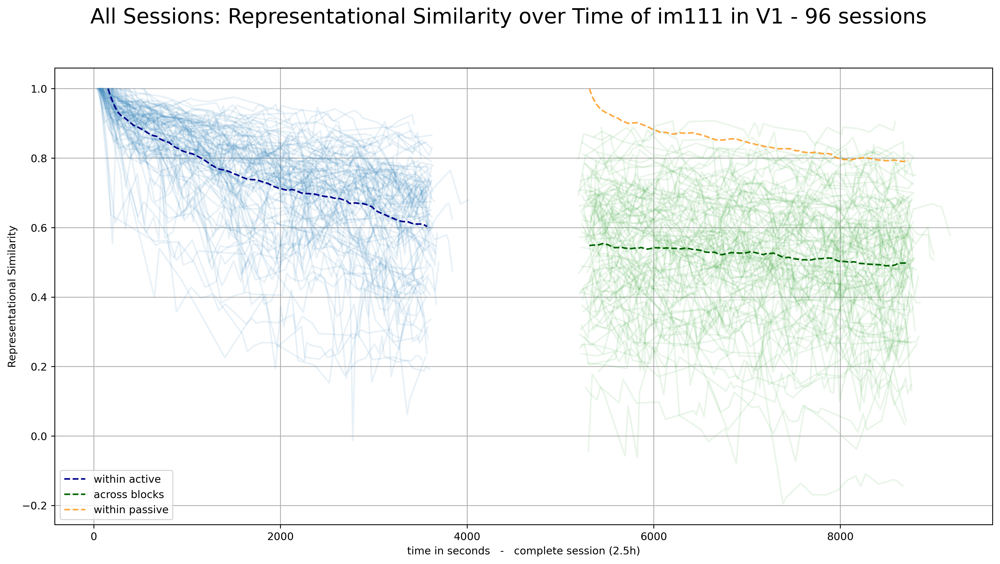

In [179]:
x1, x2, y1, y2, y3, i, u, n = conflate_all_session_responses(all_sessions_cleaned, 0)
v1_data = make_mean_curve(x1, x2, y1, y2, y3, i, u, n)

### extra

In [163]:
def extra_make_mean_curve(x_1st_half_data, x_2nd_half_data, y_act_data, y_act_pas_data, y_pas_data, image='im111', unit_set='V1', n=9):
    
    x1_list = np.empty(shape=(0,100))
    x2_list = np.empty(shape=(0,100))
    
    y1_list = np.empty(shape=(0,100))
    y2_list = np.empty(shape=(0,100))
    y3_list = np.empty(shape=(0,100))
    
    for i, x1 in enumerate(x_1st_half_data):
        x2 = x_2nd_half_data[i]
        y1 = y_act_data[i]
        y2 = y_pas_data[i]
        y3 = y_act_pas_data[i]
        
        min_x1, max_x1 = min(x1), max(x1)
        new_x1 = np.linspace(min_x1, max_x1, 100)
        min_x2, max_x2 = min(x2), max(x2)
        new_x2 = np.linspace(min_x2, max_x2, 100)
        # print(len(new_x))
        x1_list = np.vstack((x1_list, new_x1))
        x2_list = np.vstack((x2_list, new_x2))
        
        new_y1 = np.interp(new_x1, x1, y1)
        y1_list = np.vstack((y1_list, new_y1))
        new_y2 = np.interp(new_x2, x2, y2)
        y2_list = np.vstack((y2_list, new_y2))
        new_y3 = np.interp(new_x2, x2, y3)
        y3_list = np.vstack((y3_list, new_y3))
        
        
    midx1 = np.mean(x1_list, axis=0)
    midx2 = np.mean(x2_list, axis=0)
    
    midy1 = np.mean(y1_list, axis=0)
    midy2 = np.mean(y2_list, axis=0)
    midy3 = np.mean(y3_list, axis=0)
    
    # print(len(x_list), len(y_list), x_list.shape, y_list.shape, midx.shape, midy.shape)

    fig, ax = plt.subplots(figsize=(8, 6), dpi=360)
    fig.suptitle(t=f'All Sessions: Representational Similarity over Time \n of {image} in {unit_set} - {n} sessions', fontsize=20)
    
    for i in range(n):
        ax.plot(x_1st_half_data[i], y_act_data[i], c='skyblue', alpha=0.2)
        ax.plot(x_1st_half_data[i], y_pas_data[i], c='orange', alpha=0.1)

    ax.plot(midx1, midy1, '--', c='darkblue', label='within active block')
    # ax.plot(midx2, midy3, '--', c='darkorange', label='passive')
    ax.plot(midx1, midy2, '--', c='darkorange', label='within passive block')

    ax.set_xlabel('time in seconds   -   complete session (2.5h)') 
    ax.set_ylabel('Representational Similarity')
    ax.legend()
    ax.grid(axis='both', color='0.95')
    
    plt.savefig(f'plots/all_sessions_rs_in_{unit_set}_extra.png')

    return (midx1, midx2, midy1, midy2, midy3)


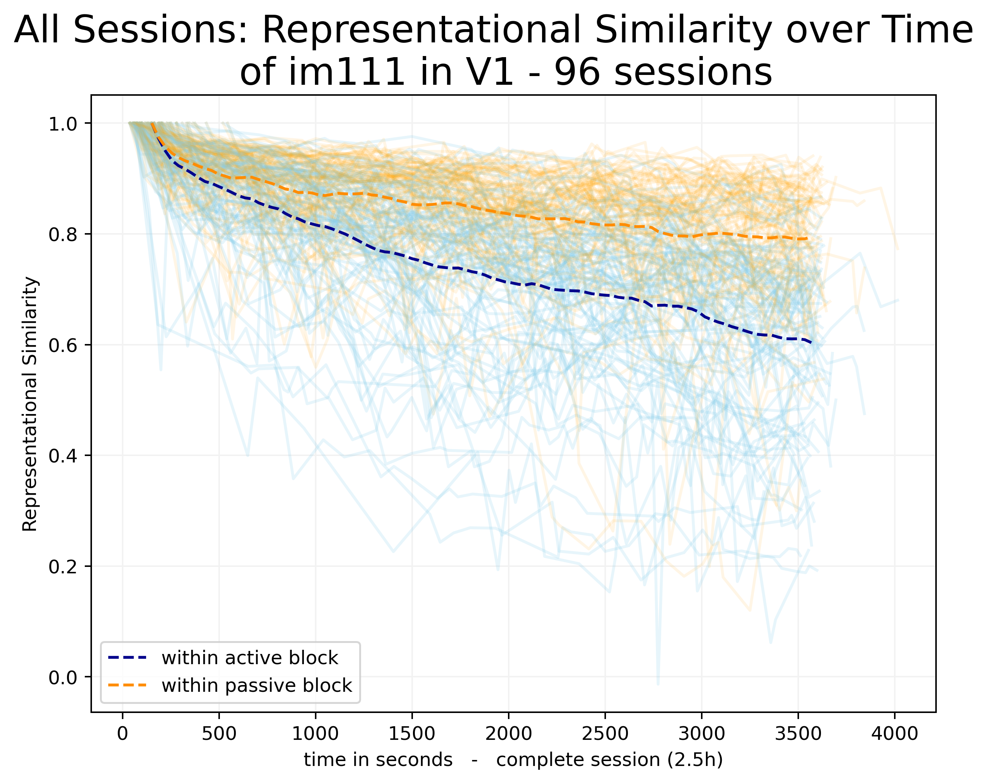

In [164]:
x1, x2, y1, y2, y3, i, u, n = conflate_all_session_responses(all_sessions_cleaned, 0)
v1_data_contrast = extra_make_mean_curve(x1, x2, y1, y2, y3, i, u, n)

In [169]:
def extra_all_sessions_by_delta_b(x_im_a, y_im_a, x_im_p, y_im_p, x_im_b, y_im_b, x_all, y_all, image, brain_structure, n):
    
    #b, m = polyfit(x_all, y_all, deg=1)
    b_a, m_a = polyfit(x_im_a, y_im_a, deg=1)
    b_p, m_p = polyfit(x_im_p, y_im_p, deg=1)
    
    
    fig, axs = plt.subplots(2, 2, figsize=(13, 8), gridspec_kw={'width_ratios': [4, 1], 'height_ratios': [1,2]}, sharex='col', sharey='row', dpi=360)
    fig.tight_layout()
    # axs[1,0].grid(axis='both', color='0.95')
    
    # active
    axs[1,0].scatter(x_im_a[::4], y_im_a[::4], alpha=0.25, s=2)
    axs[0,0].hist(x_im_a, bins=50, alpha=0.3, rwidth=0.8, label='within active')
    axs[0,0].axvline(np.mean(x_im_a), color='C0', linestyle='dashed', linewidth=1, alpha=0.5)
    axs[0,1].set_visible(False)
    axs[1,1].hist(y_im_a, bins=30, alpha=0.3, rwidth=0.8, orientation='horizontal')
    axs[1,1].axhline(np.mean(y_im_a), color='C0', linestyle='dashed', linewidth=1, alpha=0.5)
        
    # passive
    axs[1,0].scatter(x_im_p[::4], y_im_p[::4], alpha=0.25, s=2)
    axs[0,0].hist(x_im_p, bins=50, alpha=0.3, rwidth=0.8, label='within passive')
    axs[0,0].axvline(np.mean(x_im_p), color='C1', linestyle='dashed', linewidth=1, alpha=0.5)
    axs[1,1].hist(y_im_p, bins=30, alpha=0.3, rwidth=0.8, orientation='horizontal')
    axs[1,1].axhline(np.mean(y_im_p), color='C1', linestyle='dashed', linewidth=1, alpha=0.5)
    
    # means
    axs[1,0].scatter(np.mean(x_im_a), np.mean(y_im_a), marker='X', c='darkblue', edgecolor='white', s=70, label='mean active')
    axs[1,0].scatter(np.mean(x_im_p), np.mean(y_im_p), marker='X', c='darkorange', edgecolor='white', s=70, label='mean passive')
    
    # regression:
    axs[1,0].plot(x_im_a, b_a + np.multiply(m_a,x_im_a), '--', alpha=0.5)
    axs[1,0].plot(x_im_p, b_p + np.multiply(m_p,x_im_p), '--', alpha=0.5)
    # axs[1,0].plot(x_im_b, b_b + np.multiply(m_b,x_im_b), '--', alpha=0.5)
    # axs[1,0].plot(x_all, b + np.multiply(m,x_all), ls='dashed', alpha=0.5, c='black', label='regression')
    
    axs[1,0].set_xlabel("z-behaviour difference")
    axs[1,0].set_ylabel('Representational Similarity')
    
    for ax in axs.flat:
        ax.tick_params(labelbottom=True, labelleft=True)
    
    fig.legend(bbox_to_anchor =(0.97, 0.97))
    fig.suptitle(t=f'All {n} Sessions: Representational Similarity and Z-Behaviour Difference of {image} in {brain_structure}', fontsize=20, y=1.05)
    plt.savefig(f'plots/all_sess_RS_vs_delta_behaviour_in_{brain_structure}_blocks_without_acr.png', bbox_inches='tight')

96


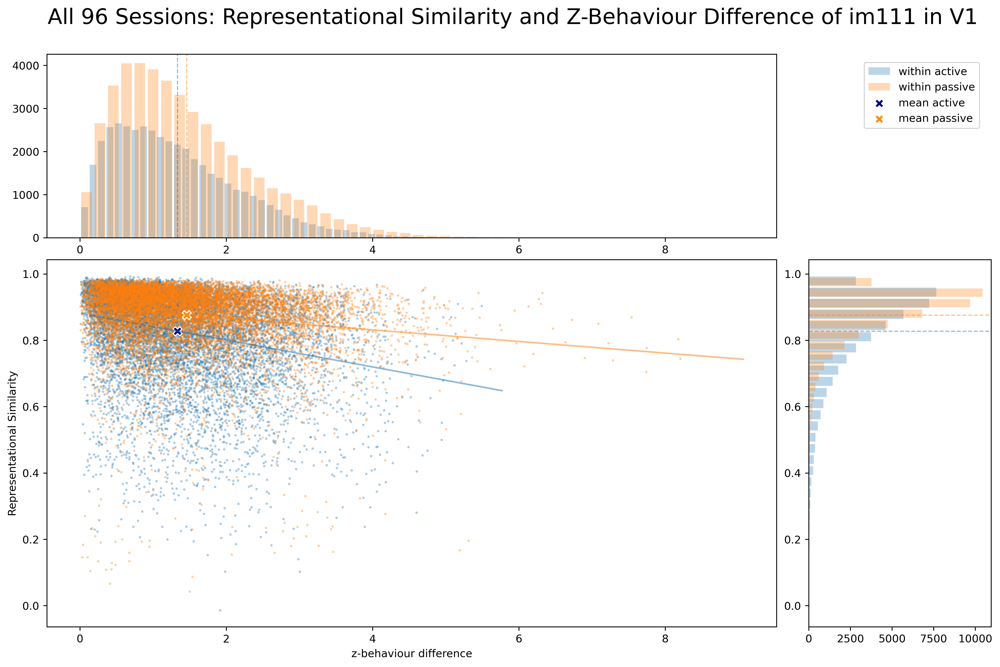

In [170]:
xa, ya, xp, yp, xb, yb, x, y, image, structure, n = append_all_session_responses(all_sessions_cleaned)

extra_all_sessions_by_delta_b(xa, ya, xp, yp, xb, yb, x, y, image, structure, n)

### hierarchy

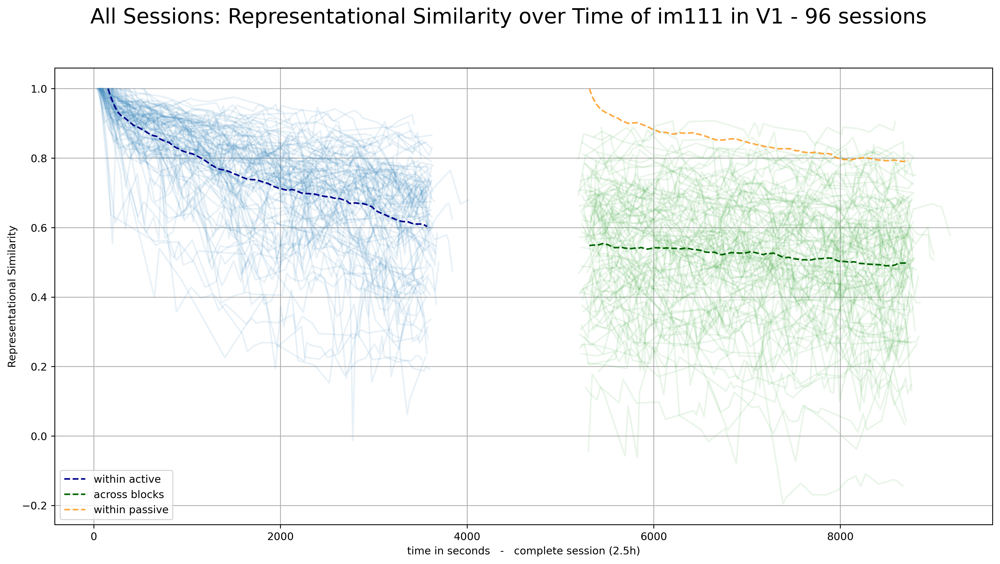

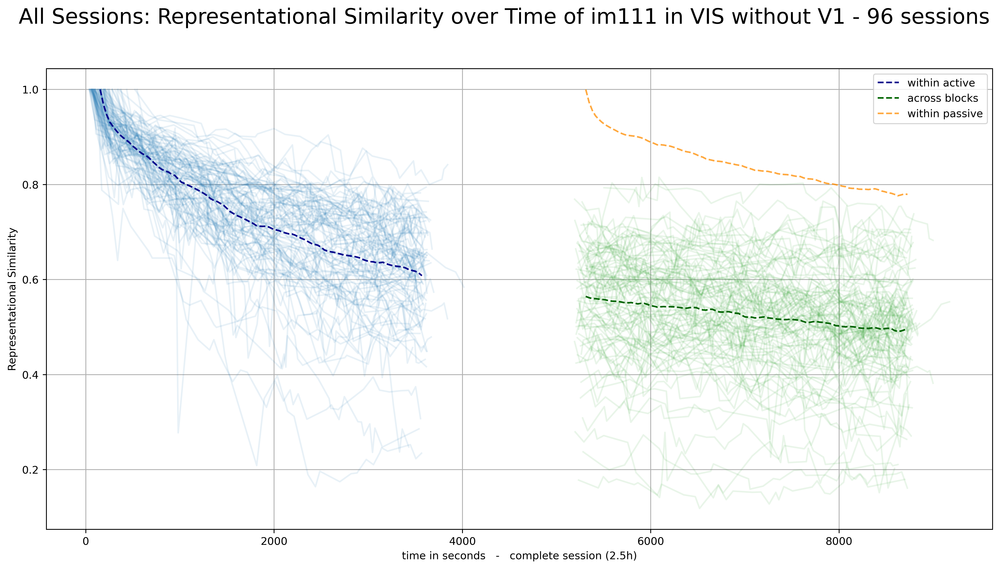

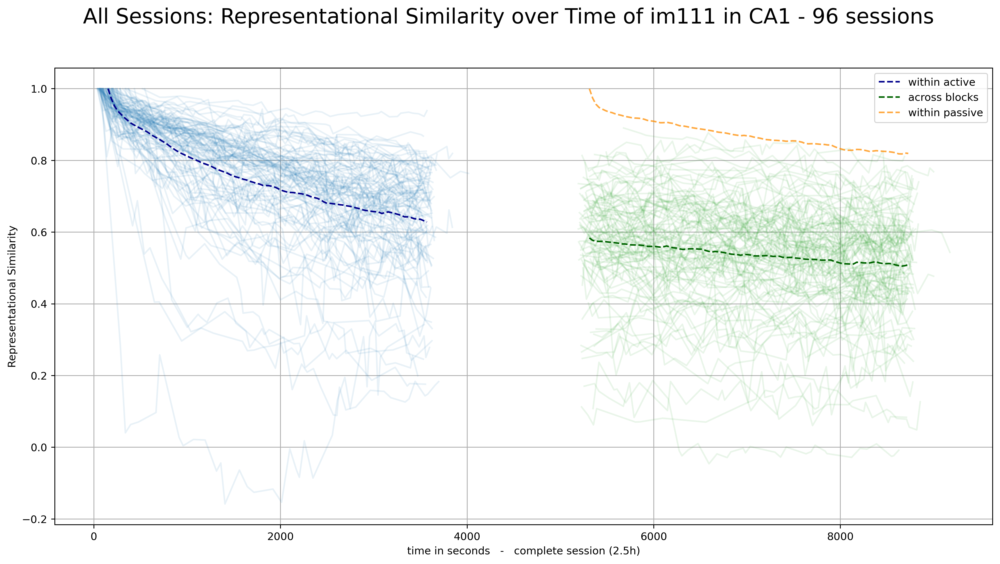

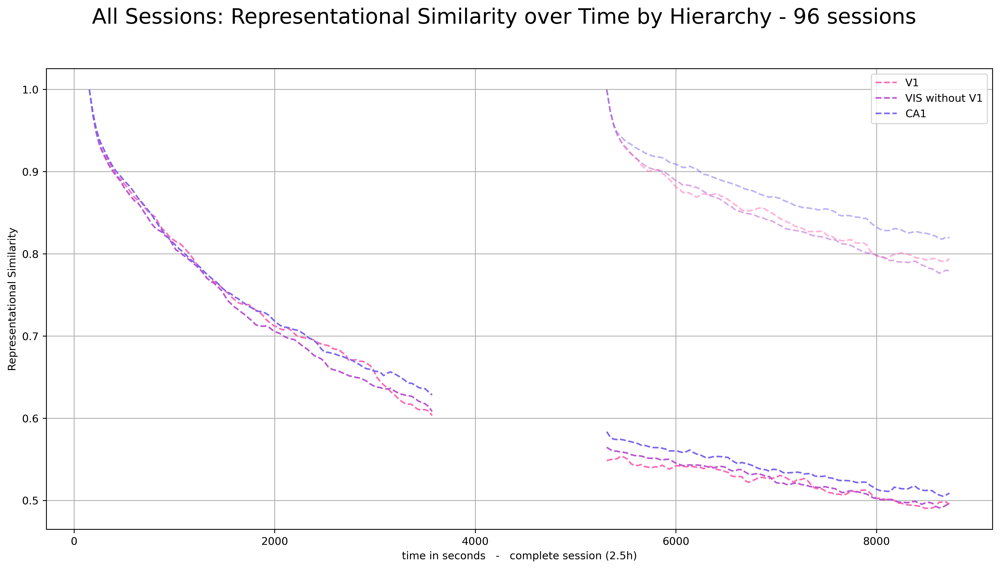

In [171]:
x1, x2, y1, y2, y3, i, u, n = conflate_all_session_responses(all_sessions_cleaned, 0)
v1_data = make_mean_curve(x1, x2, y1, y2, y3, i, u, n)
 
x1, x2, y1, y2, y3, i, u, n = conflate_all_session_responses(all_sessions_cleaned, 1)
vis_data = make_mean_curve(x1, x2, y1, y2, y3, i, u, n)

x1, x2, y1, y2, y3, i, u, n = conflate_all_session_responses(all_sessions_cleaned, 2)
ca1_data = make_mean_curve(x1, x2, y1, y2, y3, i, u, n)

all_sessions_by_hierarchy(v1_data, vis_data, ca1_data, n)

### cell types

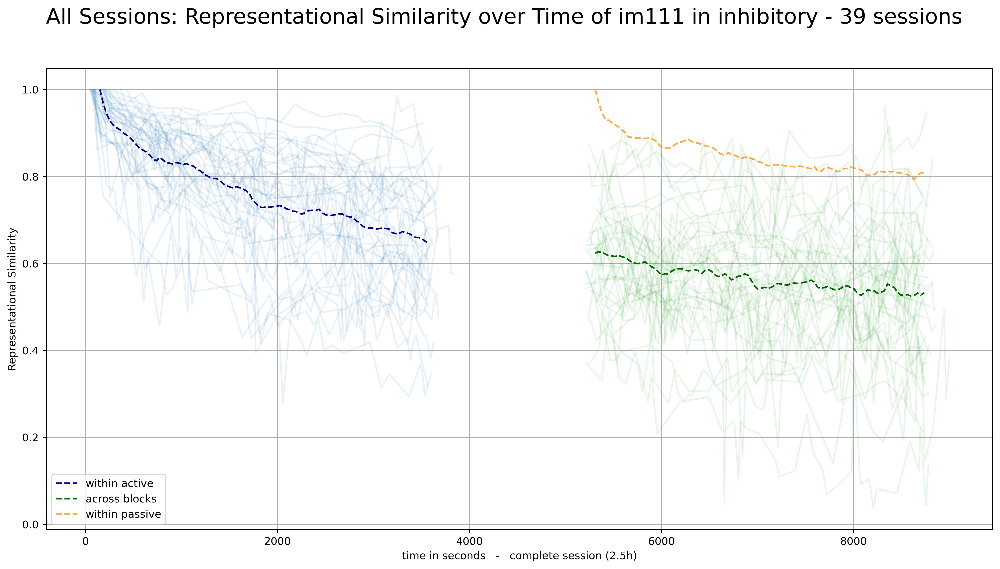

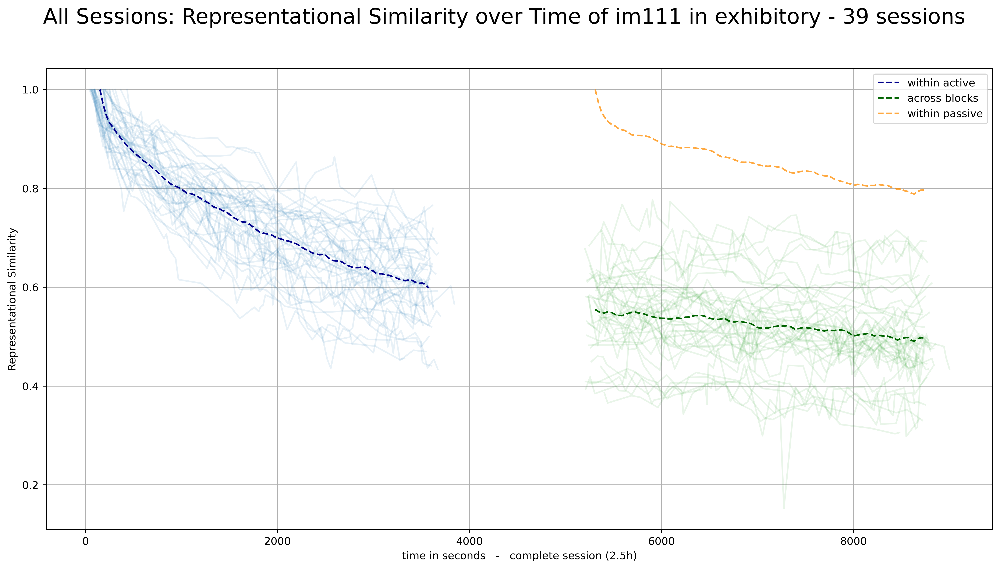

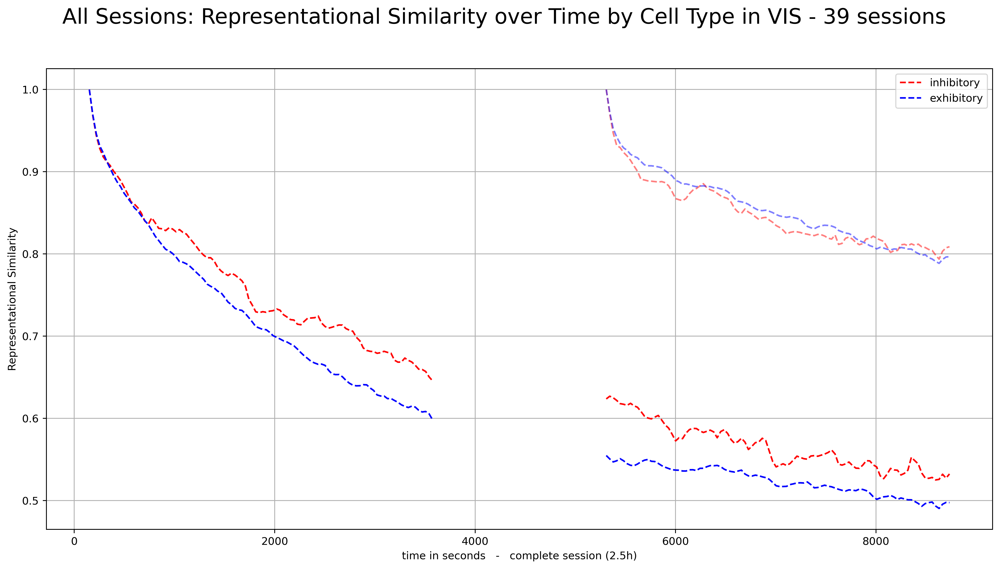

In [178]:
x1, x2, y1, y2, y3, i, u, n = conflate_all_session_responses(cell_sessions, 3)
in_data = make_mean_curve(x1, x2, y1, y2, y3, i, u, n)

x1, x2, y1, y2, y3, i, u, n = conflate_all_session_responses(cell_sessions, 4)
ex_data = make_mean_curve(x1, x2, y1, y2, y3, i, u, n)

all_sessions_by_cell_type(in_data, ex_data, n)

### novelty

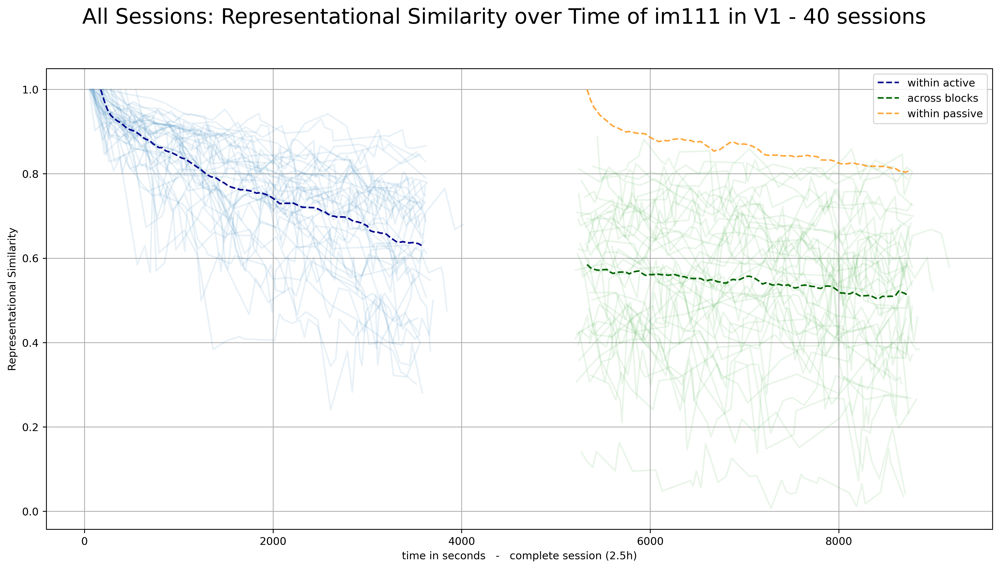

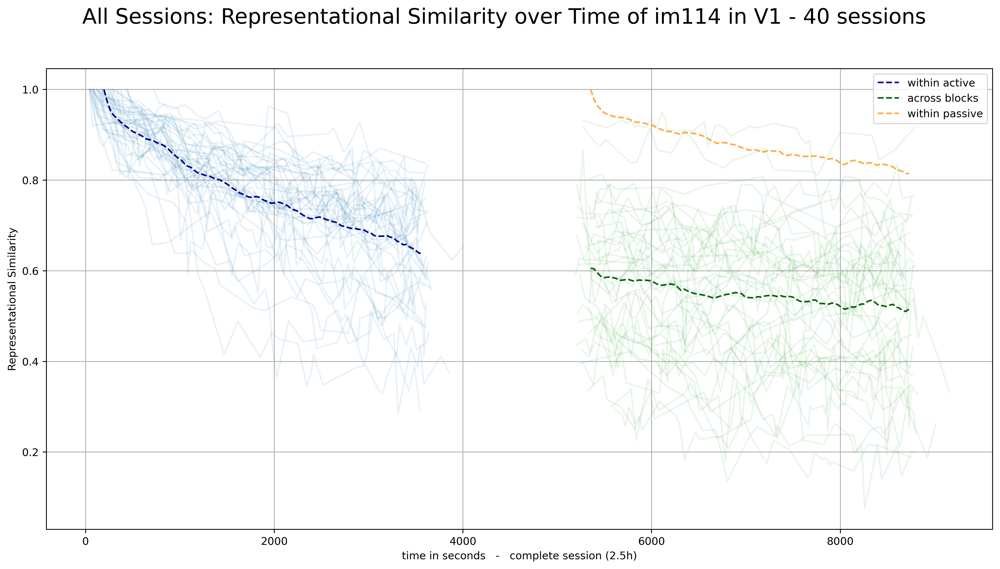

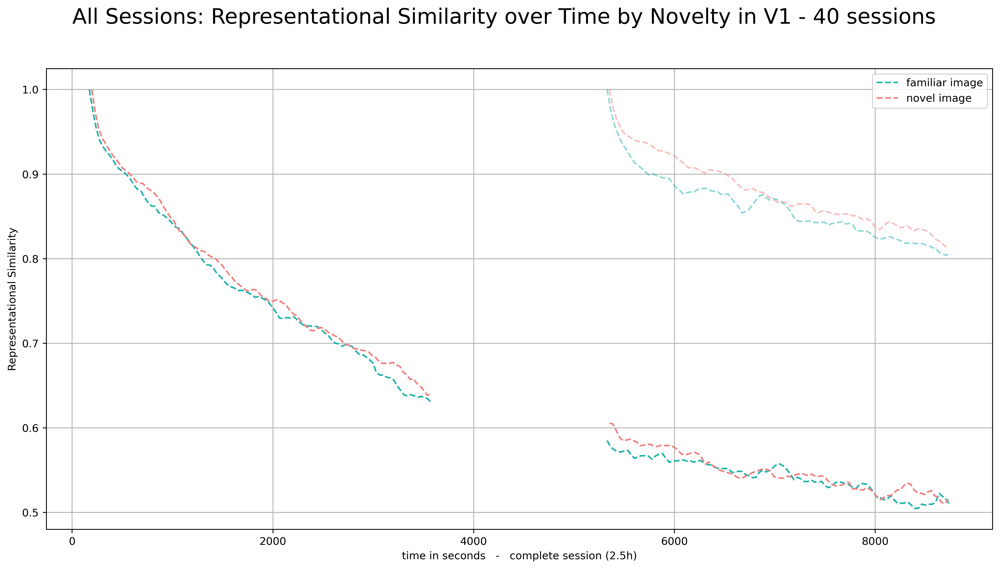

In [175]:
x1, x2, y1, y2, y3, i, u, n = conflate_all_session_responses(novel_sessions, 0) # for V1 familiar
fam_data = make_mean_curve(x1, x2, y1, y2, y3, i, u, n)

x1, x2, y1, y2, y3, i, u, n = conflate_all_session_task_related(novel_sessions, 0) # for V1 novel 
nov_data = make_mean_curve(x1, x2, y1, y2, y3, i, u, n)

all_sessions_by_novel_image(fam_data, nov_data, n, u)

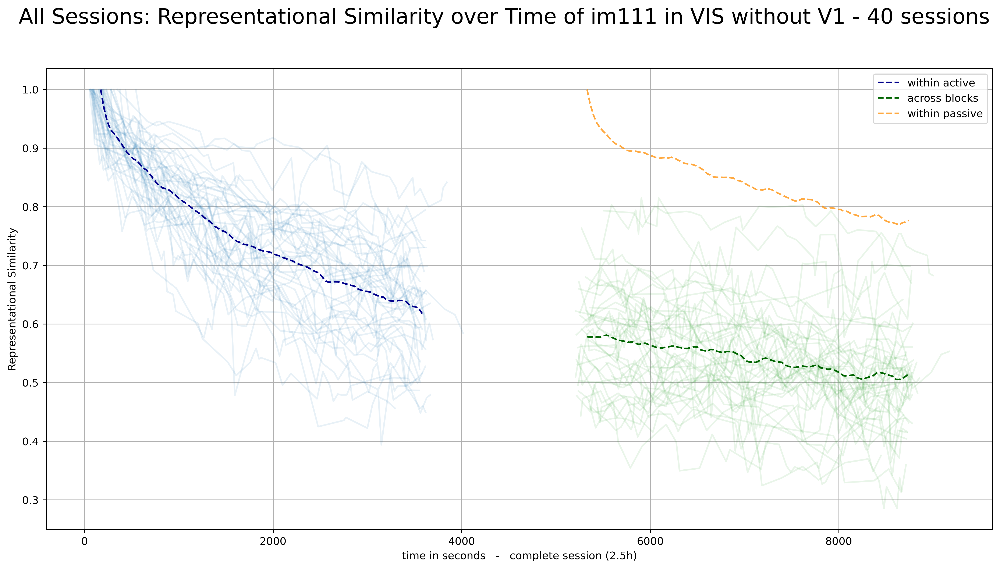

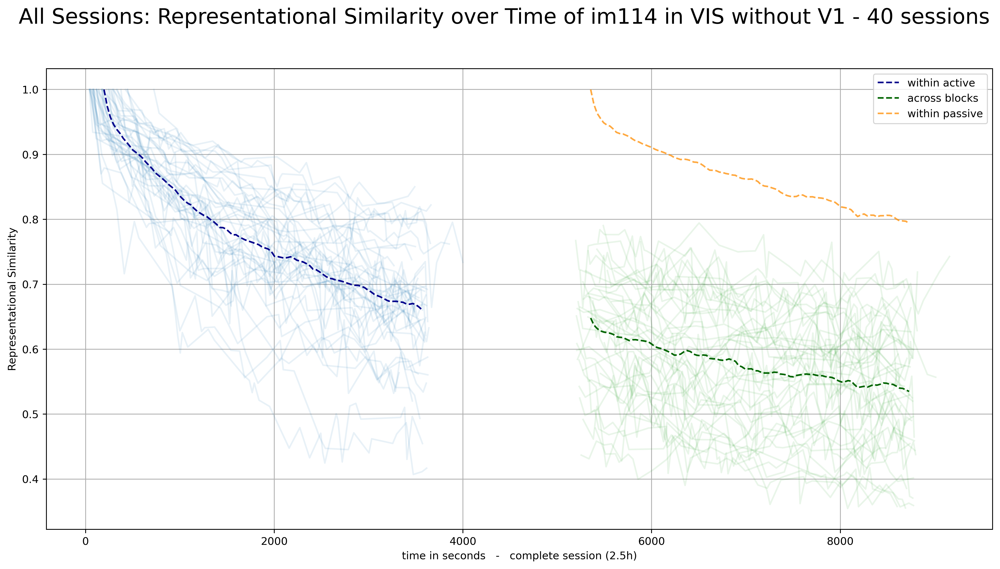

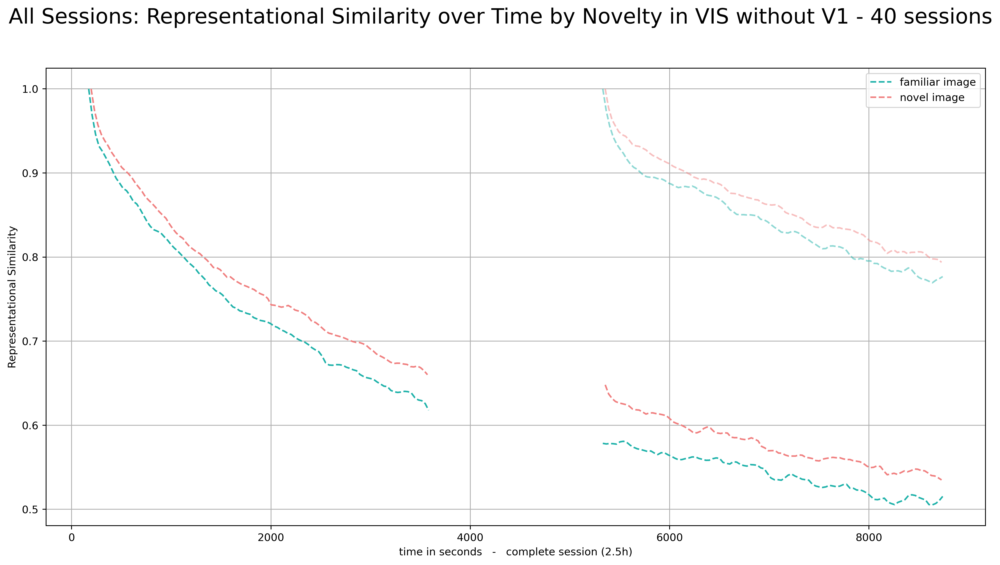

In [174]:
x1, x2, y1, y2, y3, i, u, n = conflate_all_session_responses(novel_sessions, 1) # for VIS familiar
fam_data = make_mean_curve(x1, x2, y1, y2, y3, i, u, n)

x1, x2, y1, y2, y3, i, u, n = conflate_all_session_task_related(novel_sessions, 1) # for VIS novel 
nov_data = make_mean_curve(x1, x2, y1, y2, y3, i, u, n)

all_sessions_by_novel_image(fam_data, nov_data, n, u)

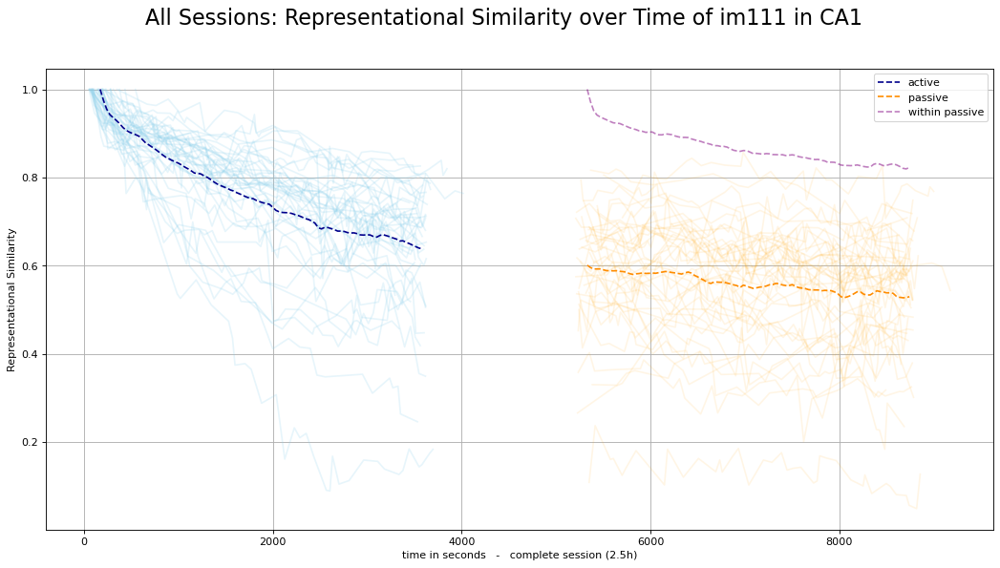

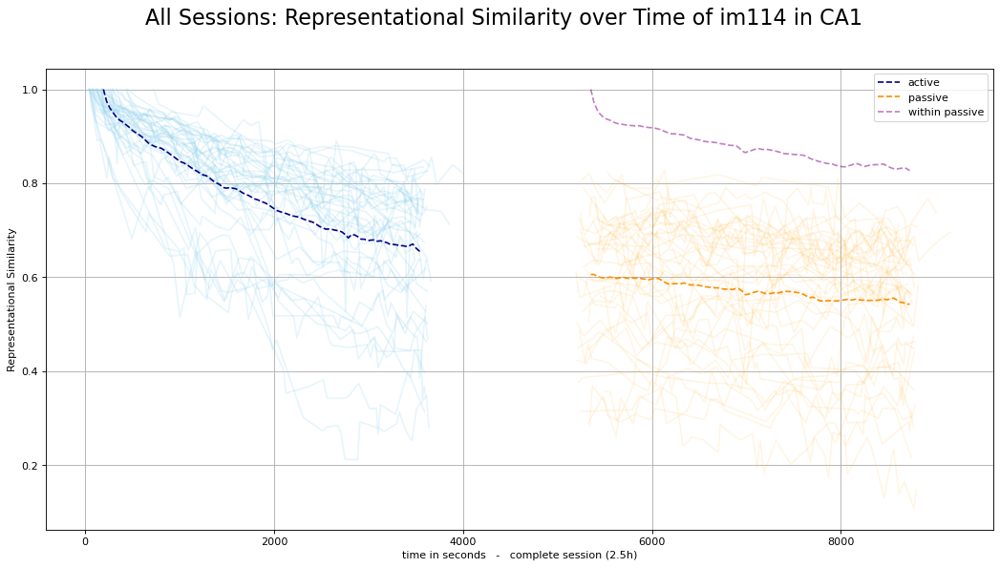

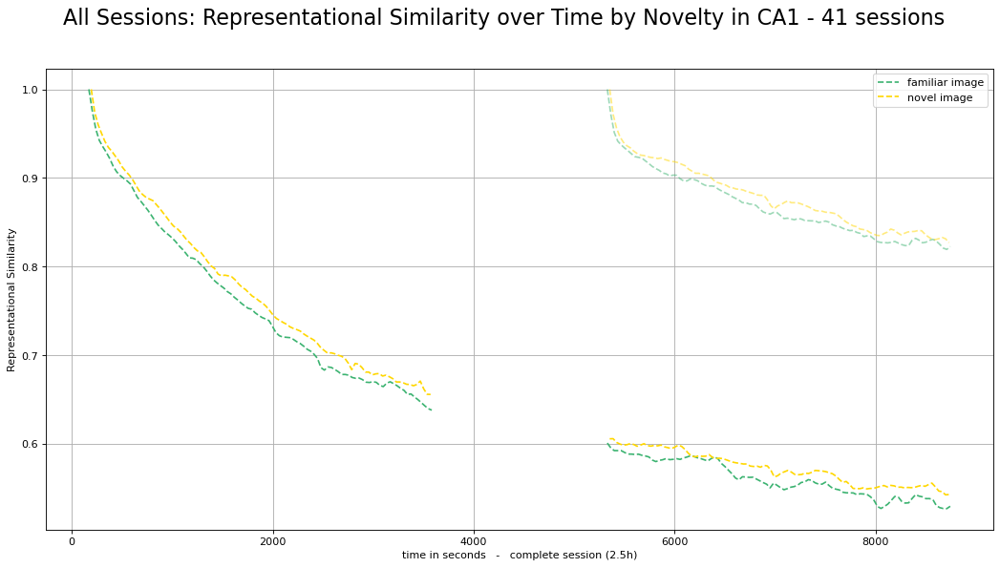

In [295]:
x1, x2, y1, y2, y3, i, u, n = conflate_all_session_responses(novel_sessions, 2) # for CA1 familiar
fam_data = make_mean_curve(x1, x2, y1, y2, y3, i, u, n)

x1, x2, y1, y2, y3, i, u, n = conflate_all_session_task_related(novel_sessions, 2) # for CA1 novel 
nov_data = make_mean_curve(x1, x2, y1, y2, y3, i, u, n)

all_sessions_by_novel_image(fam_data, nov_data, n, u)

### behaviour

96


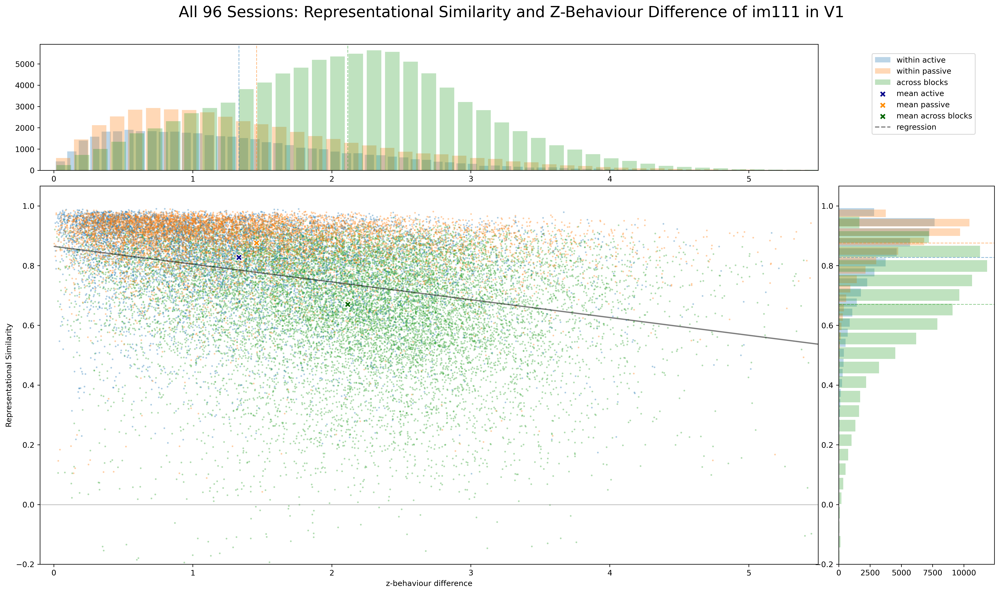

In [176]:
xa, ya, xp, yp, xb, yb, x, y, image, structure, n = append_all_session_responses(all_sessions_cleaned)

all_sessions_by_delta_b(xa, ya, xp, yp, xb, yb, x, y, image, structure, n)

### cleaning and filter for sessions that have all hierarchy levels recorded

In [58]:
# whats going on with session 72? and 91?
all_sessions[72].responses[0].info()
all_sessions[71].responses[0].x_timings
all_sessions[72].responses[0].y_active

Hello I'm V1 in response to stimuli im111_r


array([1.        , 0.96739859, 0.90296434, 0.91933455, 0.89479004,
       0.93018895, 0.92046904, 0.89084045, 0.8921081 , 0.8303763 ,
       0.83022417, 0.82166149, 0.84561622, 0.80738077, 0.77866239,
       0.80071078, 0.81528409, 0.79159819, 0.76063854, 0.79306629,
       0.67995376, 0.75509464, 0.80051673, 0.80973135, 0.76526442,
       0.60996493, 0.78898311, 0.76987511, 0.6184358 , 0.73794295,
       0.70477527, 0.67569533, 0.72168137, 0.72382567, 0.692819  ,
       0.67680707])

In [57]:
all_sessions[71].responses[0].info()
# all_sessions[71].responses[0].x_timings
all_sessions[71].responses[0].y_active

Hello I'm V1 in response to stimuli im111_r


array([nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
       nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
       nan, nan, nan])

In [59]:
all_sessions[92].responses[0].y_active

array([nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
       nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan])

In [60]:
# all_sessions_cleaned = all_sessions.copy()
# all_sessions_cleaned.pop(71)
# all_sessions_cleaned.pop(91) # bzw index 92 from original
# all_sessions_cleaned.pop(99) # too long curve, late x values
# sess_without_CA1 = all_sessions_cleaned.pop(35)
# sess2_without_CA1 = all_sessions_cleaned.pop(58)
# sess3_without_CA1 = all_sessions_cleaned.pop(58)
# sess_with_nan_in_behaviour_data = all_sessions_cleaned.pop(51)



In [61]:
all_sessions_cleaned[71].responses[0].y_active

array([1.        , 0.96536036, 0.94959271, 0.93586805, 0.9294461 ,
       0.92475364, 0.92889731, 0.93033396, 0.91687962, 0.92702497,
       0.8955343 , 0.90796922, 0.91259551, 0.86872404, 0.89161567,
       0.86450442, 0.86406191, 0.84351219, 0.84924656, 0.86821308,
       0.81792888, 0.78664428, 0.75897383, 0.76384297, 0.73065903,
       0.73308862, 0.70594035, 0.72170691, 0.68318074, 0.67326476,
       0.62919015, 0.68875096, 0.71537136, 0.73066057, 0.64350712,
       0.69533783, 0.64795196, 0.63814631, 0.65081808])

In [62]:
all_sessions_cleaned[91].responses[0].y_active

array([1.        , 0.96671173, 0.96220782, 0.94200661, 0.9187851 ,
       0.89982413, 0.87897044, 0.71750819, 0.84394197, 0.87257426,
       0.88213918, 0.86551548, 0.8411215 , 0.66468357, 0.75299874,
       0.71933784, 0.68958517, 0.70850546, 0.72065374, 0.73689458,
       0.71697874, 0.70267962, 0.70853866, 0.68977732, 0.69293592,
       0.63956084, 0.68511386])

In [163]:
len(all_sessions_cleaned), len(all_sessions)

(97, 103)

In [63]:
# number 99 makes the too long curve?? - yes
all_sessions_cleaned[98].responses[0].x_timings, all_sessions_cleaned[99].responses[0].x_timings


IndexError: list index out of range

In [64]:
all_sessions_cleaned[35].responses[2].y_active

array([1.        , 0.92260583, 0.91747492, 0.85852851, 0.76756885,
       0.79918802, 0.76510391, 0.73031441, 0.59877212, 0.5623845 ,
       0.5471575 , 0.53496369, 0.56006623, 0.59450782, 0.56168191,
       0.55913008, 0.54894336, 0.61990031, 0.51871163, 0.59898324,
       0.59103321, 0.58520703, 0.62830889, 0.61082661, 0.62261854,
       0.53289464])

In [65]:
all_sessions_cleaned[58].responses[2].y_active

array([1.        , 0.84063801, 0.78315076, 0.94801408, 0.96818413,
       0.96129315, 0.92701858, 0.41179539, 0.33457091, 0.37090526,
       0.36270466, 0.34847178, 0.40239337, 0.41586864, 0.34581218,
       0.32365012, 0.27836034, 0.330554  , 0.31477334, 0.32816449,
       0.2887476 , 0.28972982, 0.22187437, 0.27072239, 0.30993067,
       0.34603292, 0.32985106, 0.26164208, 0.27604387, 0.26519475,
       0.23005672, 0.23542663, 0.22144641, 0.2547752 , 0.19950718])

In [68]:
#for i, session in enumerate(all_sessions_cleaned):
    # print(i, np.all(np.isfinite(session.behaviour[0].x_pas)))  

    
all_sessions_cleaned[51].behaviour[0].y_all[:5]

[0.9688865919599002,
 0.8762748188858617,
 0.8054208141606729,
 0.8431616881527665,
 0.9049133109684699]

### filter for optotagging

In [75]:
cell_sessions = []
for session in all_sessions_cleaned:
    # print(len(session.responses))
    if session.gen_type != 'wt':
        # print(session.responses[3].y_active)
        # print(session.responses[4].y_active)
        if not np.isnan(session.responses[3].y_active).any():
            if not np.any(session.responses[3].y_active < 0) and not np.any(session.responses[3].y_act_pas < 0): 
                # print(session.responses[3].y_active)
                cell_sessions.append(session)
            
        

In [76]:
len(cell_sessions)

39

### filter for novel

In [77]:
novel_sessions = []
for session in all_sessions_cleaned:
    if session.novel:
        print(session.task_related[0].y_active)
        novel_sessions.append(session)

[1.         0.95390287 0.96448896 0.95200353 0.93231129 0.9171788
 0.90124482 0.9389038  0.8649334  0.79134808 0.77680866 0.80690922
 0.85374934 0.81016725 0.8244828  0.73523453 0.84755059 0.72461247
 0.77485256 0.65402423 0.6508243  0.68521027 0.58950851 0.65729683
 0.64356862 0.58142968 0.57683914 0.62753283 0.60320751 0.62970443
 0.60719028 0.51590392 0.58614645 0.47776298 0.52700748 0.47759811]
[1.         0.8971671  0.96277955 0.9617127  0.87725025 0.94347949
 0.92316656 0.77436162 0.76157863 0.67341623 0.61329131 0.62111503
 0.59309468 0.56369201 0.52759333 0.55974186 0.50790563 0.42519999
 0.36479706 0.48936805 0.4435857  0.45023379 0.49550466 0.51291009
 0.48852032 0.50312909 0.44479212 0.49466448 0.51175697 0.46351205
 0.4117579  0.48051627 0.43667401 0.4773982  0.42606347 0.44179214
 0.46606571]
[1.         0.90882222 0.89063879 0.82526873 0.76835794 0.8165527
 0.84657856 0.78716467 0.78412279 0.75458716 0.78808374 0.73134122
 0.73153246 0.72653754 0.71813472 0.77909282 0.693

In [78]:
len(novel_sessions)

40

### other

In [276]:
n_v1 = []
for session in all_sessions_cleaned:
    n_v1.append(session.M_good_VISp.shape[0])
    # print(session.M_good_VISp.shape[0])
print(np.mean(np.asarray(n_v1)), np.max(n_v1), np.min(n_v1))

76.05208333333333 121 15


In [306]:
all_sessions_cleaned[79].info()

Hello I'm session 1118327332 of mouse 574082 with type Sst and sex M, novel=False
